<a href="https://colab.research.google.com/github/oliviasteeed/Computer-Vision-Project/blob/main/computervision_FINAL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Computer Vision Project: Text detection from images
This project identifies and types out written words from images. It uses object detection to find where text is in an image, and then detects the letters in the word.

# 0. Set up ultralytics and install dependencies

In [ ]:
!pip3 install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
Setup complete ✅ (4 CPUs, 8.0 GB RAM, 302.1/894.1 GB disk)


In [ ]:
import cv2
import matplotlib.pyplot as plt
import random as random
import os
import glob
%matplotlib inline
from PIL import Image
from ultralytics import YOLO

# 1. Text Detection

Detecting where text is in an image, and cropping images with text to bounding boxes

### A. Data Preprocessing

Datasets: three text detection datasets of images/screenshots with text enclosed in bounding boxes. I was going to try object detection for just handwriting, but found more data for typed text, so this model is intended to identify both with a bias for typed text. Because of this, the use case could also be for translation of typed text.

https://universe.roboflow.com/yolo-2uwb2/text-detection-jqlql

https://universe.roboflow.com/yolov5-train/yolo-find-text

https://universe.roboflow.com/akshithak-0pa4q/text-detection-qj5wx

In [ ]:
image_dir = '/Users/oliviasteed/Desktop/Text Dataset/images'
label_dir = '/Users/oliviasteed/Desktop/Text Dataset/labels'

dir = '/Users/oliviasteed/Desktop/Text Dataset'

In [ ]:
# write yaml file - did it this way so I could specify directory

with open('/Users/oliviasteed/Desktop/Text Dataset/config.yaml', 'w') as file:
    file.write('''\
path: /Users/oliviasteed/Desktop/Text Dataset
train: /Users/oliviasteed/Desktop/Text Dataset/images/train
test: /Users/oliviasteed/Desktop/Text Dataset/images/test
val: /Users/oliviasteed/Desktop/Text Dataset/images/val

# Classes
nc: 1

# Class names
names: ['Text']
''')

Draw a label bounding box to check accuracy

In [ ]:
# showing label - to check if it is labeled right (it is)
%matplotlib inline
from PIL import Image

def draw_yolo_bbox(image_path, label_path):
    # Load image
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    height, width, _ = image.shape

    # Read label file
    with open(label_path, 'r') as file:
        bboxes = file.readlines()

    # Draw each bbox
    for bbox in bboxes:
        class_id, x_center, y_center, bbox_width, bbox_height = [float(x) for x in bbox.split()]

        # Convert YOLO bbox format to rectangle coordinates
        x1 = int((x_center - bbox_width / 2) * width)
        y1 = int((y_center - bbox_height / 2) * height)
        x2 = int((x_center + bbox_width / 2) * width)
        y2 = int((y_center + bbox_height / 2) * height)

        # Draw rectangle
        cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 2)
        # Put label (class_id) near the bbox
        # label = class_labels[int(class_id)]
        label = "text"
        cv2.putText(image, label, (x1, y1+20), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,0,0), 2)
    # Display image
    plt.imshow(image)
    # Image.open(image)
    plt.axis('off')
    plt.savefig('test.jpg')
    return

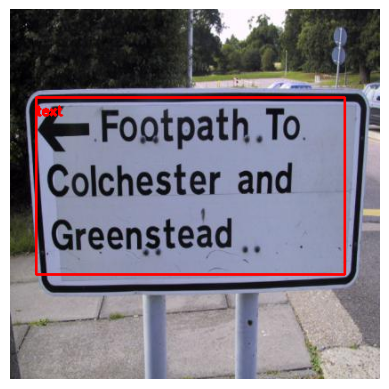

In [ ]:
draw_yolo_bbox("/Users/oliviasteed/Desktop/Text Dataset/images/train/100_jpg.rf.072e86458094f004ab381eb018f48ea0.jpg", "/Users/oliviasteed/Desktop/Text Dataset/labels/train/100_jpg.rf.072e86458094f004ab381eb018f48ea0.txt")

Check if there is unlabeled data

In [ ]:
#The lists of all the images and labels for train and validation set:
train_images=glob.glob(os.path.join(image_dir, "train",'*.jpg'))
train_labels=glob.glob(os.path.join(label_dir, "train",'*.txt'))
val_images=glob.glob(os.path.join(image_dir, "val",'*.jpg'))
val_labels=glob.glob(os.path.join(label_dir, "val",'*.txt'))
#print(val_labels)

# Get the list of filenames without extensions
image_files_train = {file.split("/")[-1].split(".")[0] for file in train_images}
label_files_train = {file.split("/")[-1].split(".")[0] for file in train_labels}

image_files_val = {file.split("/")[-1].split(".")[0] for file in val_images}
label_files_val = {file.split("/")[-1].split(".")[0] for file in val_labels}
#print(image_files_val)

In [ ]:
print(len(image_files_val), "  =  ", len(label_files_val))

243   =   243


In [ ]:
# Find extra files in each folder

#TRAINING DATA
extra_images_train = image_files_train - label_files_train
extra_labels_train = label_files_train - image_files_train

# Output the results
print(f"Training Extra images (without corresponding labels): {extra_images_train}")
print(f"Training Extra labels (without corresponding images): {extra_labels_train}")


#VALIDATION DATA
extra_images_val = image_files_val - label_files_val
extra_labels_val = label_files_val - image_files_val

# Output the results
print(f"Validation Extra images (without corresponding labels): {extra_images_val}")
print(f"Validation Extra labels (without corresponding images): {extra_labels_val}")

Training Extra images (without corresponding labels): set()
Training Extra labels (without corresponding images): set()
Validation Extra images (without corresponding labels): set()
Validation Extra labels (without corresponding images): set()


No unlabeled data, so we can move on to model training.

### B. Transfer Learning for Object Detection

#### i. Initial Training:
3 epochs and 0.1 learning rate - learning faster with less trials. Recall is 0.855 and m is 0.657.

In [ ]:
# initial trial - 3 epochs

# make new model to train and load in weights from existing YOLO detection model
model0 = YOLO("yolov8n.yaml").load("yolov8n.pt")

# train model with text object detection data
results0 = model0.train(data="/Users/oliviasteed/Desktop/Text Dataset/config.yaml", epochs=3, patience=5, batch=8, lr0=0.1)

Transferred 355/355 items from pretrained weights
New https://pypi.org/project/ultralytics/8.3.27 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.yaml, data=/Users/oliviasteed/Desktop/Text Dataset/config.yaml, epochs=3, time=None, patience=5, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train12, exist_ok=False, pretrained=yolov8n.pt, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnost

train: Scanning /Users/oliviasteed/Desktop/Text Dataset/labels/train.cache... 84
val: Scanning /Users/oliviasteed/Desktop/Text Dataset/labels/val.cache... 247 im

Plotting labels to runs/detect/train12/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.1' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train12
Starting training for 3 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/3         0G      1.275        1.6      1.189          1        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all        247        652      0.814      0.805      0.877      0.521

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/3         0G      1.179      1.176      1.134          3        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all        247        652      0.868      0.784      0.875      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/3         0G      1.118     0.9915      1.091          6        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all        247        652      0.969      0.856      0.954      0.657

3 epochs completed in 1.607 hours.
Optimizer stripped from runs/detect/train12/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train12/weights/best.pt, 6.2MB

Validating runs/detect/train12/weights/best.pt...
WARNING ⚠️ validating an untrained model YAML will result in 0 mAP.
Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
YOLOv8n summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all        247        652      0.969      0.855      0.954      0.657
Speed: 9.6ms preprocess, 423.8ms inference, 0.0ms loss, 14.1ms postprocess per image
Results saved to runs/detect/train12


In [ ]:
# load up 3 epoch model
model0 = YOLO("/Users/oliviasteed/runs/detect/train12/weights/best.pt")

In [ ]:
metrics0 = model0.val() # general validation

metrics0.box.map    # map50-95
metrics0.box.mp    # P
metrics0.box.mr    # R

Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)


val: Scanning /Users/oliviasteed/Desktop/Text Dataset/labels/val.cache... 247 im
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all        247        652      0.969      0.855      0.954      0.657
Speed: 5.9ms preprocess, 247.4ms inference, 0.0ms loss, 7.9ms postprocess per image
Results saved to runs/detect/val10


0.855321429428535

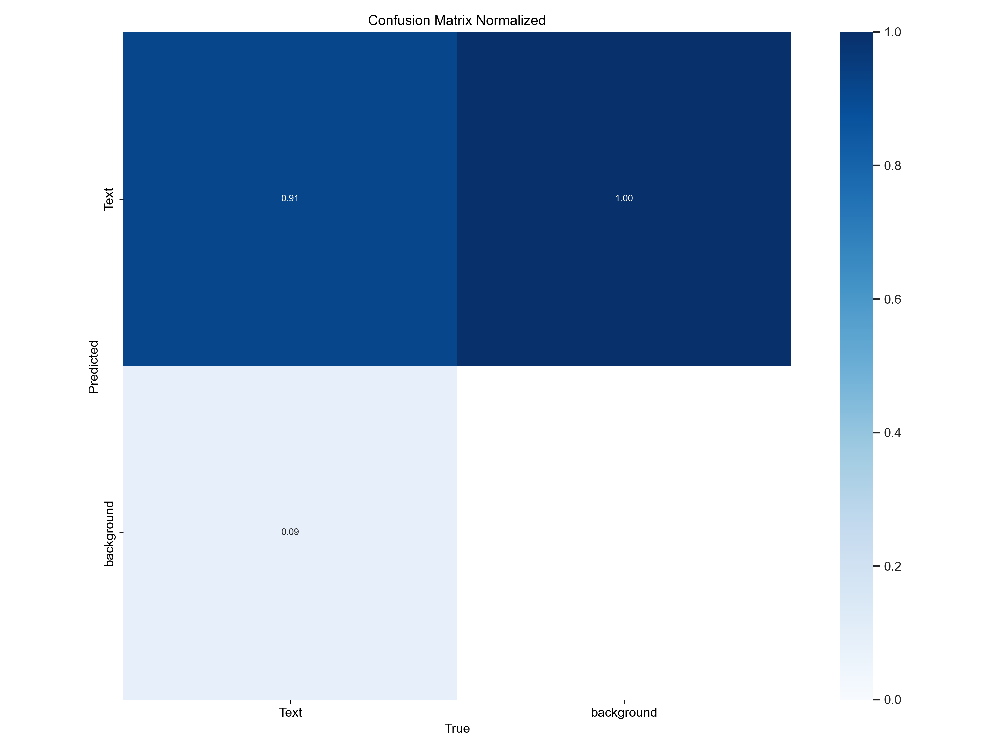

In [ ]:
# show confusion matrix to analyze overall accuracy

Image.open('/Users/oliviasteed/runs/detect/train122/confusion_matrix_normalized.png')

In [ ]:
# test on image
model0("/Users/oliviasteed/Desktop/Text Dataset/images/test/Ar_20_An_20_TNR_20_Image208_jpg.rf.ef6420dfbedd7e91058de62af18cdb16.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/Text Dataset/images/test/Ar_20_An_20_TNR_20_Image208_jpg.rf.ef6420dfbedd7e91058de62af18cdb16.jpg: 640x640 3 Texts, 409.0ms
Speed: 5.2ms preprocess, 409.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict10


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Text'}
 obb: None
 orig_img: array([[[112, 168, 179],
         [115, 159, 172],
         [142, 157, 176],
         ...,
         [ 89, 114, 140],
         [ 92, 115, 141],
         [ 92, 115, 141]],
 
        [[116, 159, 174],
         [125, 155, 172],
         [151, 156, 177],
         ...,
         [ 89, 114, 140],
         [ 92, 115, 141],
         [ 92, 115, 141]],
 
        [[138, 155, 176],
         [149, 155, 178],
         [171, 154, 181],
         ...,
         [ 90, 115, 141],
         [ 92, 115, 141],
         [ 92, 115, 141]],
 
        ...,
 
        [[137, 162, 188],
         [137, 162, 188],
         [138, 163, 189],
         ...,
         [122, 140, 163],
         [121, 140, 167],
         [117, 138, 166]],
 
        [[137, 162, 188],
         [137, 162, 188],
         [138, 163, 189],
         ...,
         [122, 140, 

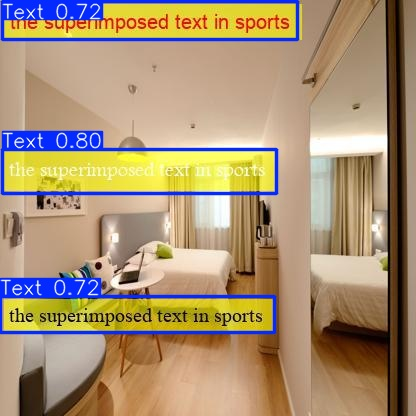

In [ ]:
# accurate
Image.open("/Users/oliviasteed/runs/detect/predict10/Ar_20_An_20_TNR_20_Image208_jpg.rf.ef6420dfbedd7e91058de62af18cdb16.jpg")

In [ ]:
model0("/Users/oliviasteed/Desktop/Text Dataset/images/test/131_jpg.rf.763bd19306a14361c61fa89d88441f6f.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/Text Dataset/images/test/131_jpg.rf.763bd19306a14361c61fa89d88441f6f.jpg: 640x640 3 Texts, 413.3ms
Speed: 32.7ms preprocess, 413.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict10


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Text'}
 obb: None
 orig_img: array([[[140,  98,  85],
         [165, 117, 105],
         [198, 139, 130],
         ...,
         [255, 183, 179],
         [255, 183, 179],
         [255, 183, 179]],
 
        [[123,  84,  70],
         [137,  92,  79],
         [161, 102,  93],
         ...,
         [255, 183, 179],
         [255, 183, 179],
         [255, 183, 179]],
 
        [[120,  83,  69],
         [119,  77,  64],
         [129,  74,  65],
         ...,
         [255, 183, 179],
         [255, 183, 179],
         [255, 183, 179]],
 
        ...,
 
        [[ 28,  17,  13],
         [ 29,  18,  14],
         [ 29,  17,  15],
         ...,
         [ 89,  39,  27],
         [ 90,  40,  28],
         [ 91,  42,  28]],
 
        [[ 28,  17,  13],
         [ 28,  17,  13],
         [ 28,  16,  14],
         ...,
         [ 93,  41, 

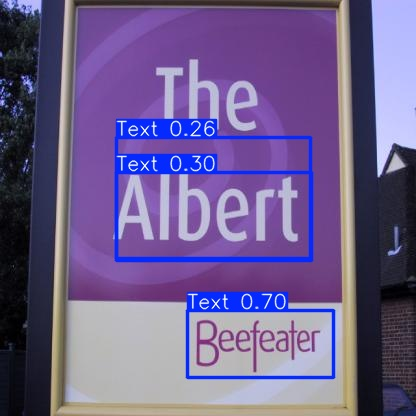

In [ ]:
# not totally accurate
Image.open("/Users/oliviasteed/runs/detect/predict10/131_jpg.rf.763bd19306a14361c61fa89d88441f6f.jpg")

In [ ]:
model0("/Users/oliviasteed/Desktop/Text Dataset/images/test/img_10_jpg.rf.b4d88aca0484d27432a317b796b5e28e.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/Text Dataset/images/test/img_10_jpg.rf.b4d88aca0484d27432a317b796b5e28e.jpg: 640x640 1 Text, 435.1ms
Speed: 19.7ms preprocess, 435.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict10


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Text'}
 obb: None
 orig_img: array([[[153, 149, 130],
         [151, 147, 128],
         [149, 145, 126],
         ...,
         [151, 144, 125],
         [150, 143, 124],
         [150, 143, 124]],
 
        [[153, 149, 130],
         [151, 147, 128],
         [150, 146, 127],
         ...,
         [151, 144, 125],
         [150, 143, 124],
         [150, 143, 124]],
 
        [[152, 148, 129],
         [151, 147, 128],
         [150, 146, 127],
         ...,
         [151, 144, 125],
         [150, 143, 124],
         [150, 143, 124]],
 
        ...,
 
        [[123, 119, 101],
         [122, 118, 100],
         [117, 113,  95],
         ...,
         [ 21,  13,   6],
         [ 21,  13,   6],
         [ 21,  13,   6]],
 
        [[123, 119, 101],
         [121, 117,  99],
         [117, 113,  95],
         ...,
         [ 21,  13, 

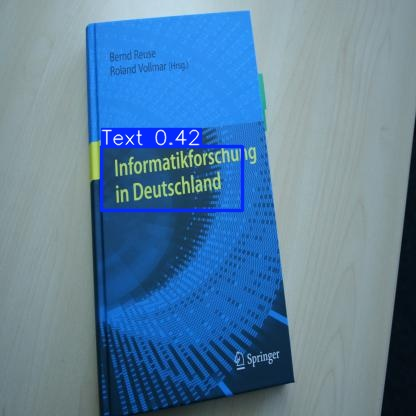

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict10/img_10_jpg.rf.b4d88aca0484d27432a317b796b5e28e.jpg")

Pretty good, but not great accuracy - it does catch most of the text but misses some text and interprets some text twice. Let's try wih more epochs and a slower learning rate.

#### ii. Training trial 2:
8 epochs and 0.0005 learning rate - learning slower with more trials. Recall is 0.949 and m is 0.717 - a significant improvement. Because of better performance I will use this one.

In [ ]:
# make new model to train and load in weights from existing YOLO detection model
model = YOLO("yolov8n.yaml").load("yolov8n.pt")

# train model with text object detection data
results = model.train(data="/Users/oliviasteed/Desktop/Text Dataset/config.yaml", epochs=8, patience=5, batch=8, lr0=0.0005)

Transferred 355/355 items from pretrained weights
New https://pypi.org/project/ultralytics/8.3.23 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.yaml, data=/Users/oliviasteed/Desktop/Text Dataset/config.yaml, epochs=8, time=None, patience=5, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=yolov8n.pt, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnosti

train: Scanning /Users/oliviasteed/Desktop/Text Dataset/labels/train.cache... 84
val: Scanning /Users/oliviasteed/Desktop/Text Dataset/labels/val.cache... 247 im


Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0005' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train3
Starting training for 8 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/8         0G      1.301      1.651      1.202          2        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all        247        652       0.77      0.782      0.825      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/8         0G      1.202      1.177      1.148          6        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all        247        652      0.901      0.839      0.907       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/8         0G      1.185      1.087      1.152          4        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all        247        652      0.918      0.859      0.941      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/8         0G      1.149     0.9795      1.136          6        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all        247        652      0.919      0.902      0.955       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/8         0G      1.098     0.8674      1.103          4        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all        247        652      0.959      0.894      0.969      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        6/8         0G      1.055     0.8059      1.094          3        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all        247        652      0.952      0.907      0.971      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        7/8         0G      1.046     0.7768      1.077         10        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all        247        652       0.96      0.923      0.973      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        8/8         0G      1.005     0.7216      1.068         10        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all        247        652      0.949       0.95      0.981      0.717



8 epochs completed in 1.702 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 6.2MB

Validating runs/detect/train3/weights/best.pt...
WARNING ⚠️ validating an untrained model YAML will result in 0 mAP.
Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
YOLOv8n summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all        247        652      0.949      0.949      0.981      0.717
Speed: 5.1ms preprocess, 215.8ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to runs/detect/train3


### C. Validation
I want to minimize errors with bounding boxes so will use Precision, Recall, and mAP for an overview of model performance.

In [ ]:
metrics = model.val() # general validation

metrics.box.map    # map50-95
metrics.box.mp    # P
metrics.box.mr    # R

Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)


val: Scanning /Users/oliviasteed/Desktop/Text Dataset/labels/val.cache... 247 im
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all        247        652      0.949      0.949      0.981      0.717
Speed: 5.9ms preprocess, 245.5ms inference, 0.0ms loss, 2.5ms postprocess per image
Results saved to runs/detect/val11


0.9492219119233806

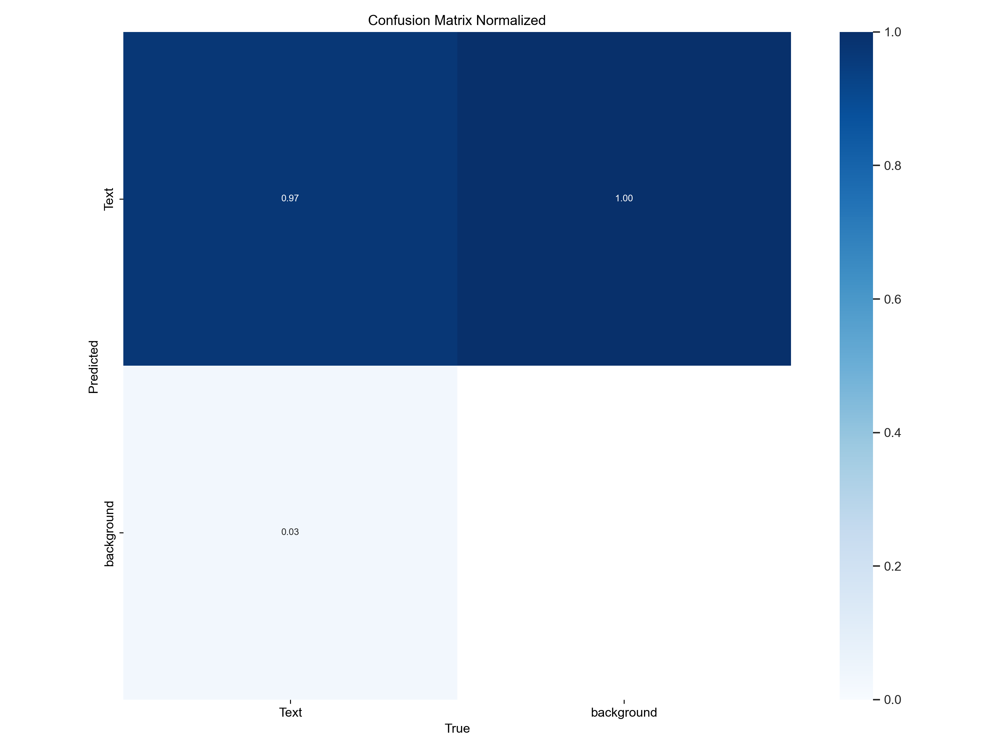

In [ ]:
# show confusion matrix to analyze overall accuracy

Image.open('/Users/oliviasteed/runs/detect/train3/confusion_matrix_normalized.png')

### D. Test (Text detection)

Testing model on test set images

In [ ]:
# load saved model (so don't have to train it again)
model = YOLO("/Users/oliviasteed/runs/detect/train3/weights/best.pt")  # this is the model path

In [ ]:
# predict on same image
model("/Users/oliviasteed/Desktop/Text Dataset/images/test/131_jpg.rf.763bd19306a14361c61fa89d88441f6f.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/Text Dataset/images/test/131_jpg.rf.763bd19306a14361c61fa89d88441f6f.jpg: 640x640 2 Texts, 348.9ms
Speed: 10.0ms preprocess, 348.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict11


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Text'}
 obb: None
 orig_img: array([[[140,  98,  85],
         [165, 117, 105],
         [198, 139, 130],
         ...,
         [255, 183, 179],
         [255, 183, 179],
         [255, 183, 179]],
 
        [[123,  84,  70],
         [137,  92,  79],
         [161, 102,  93],
         ...,
         [255, 183, 179],
         [255, 183, 179],
         [255, 183, 179]],
 
        [[120,  83,  69],
         [119,  77,  64],
         [129,  74,  65],
         ...,
         [255, 183, 179],
         [255, 183, 179],
         [255, 183, 179]],
 
        ...,
 
        [[ 28,  17,  13],
         [ 29,  18,  14],
         [ 29,  17,  15],
         ...,
         [ 89,  39,  27],
         [ 90,  40,  28],
         [ 91,  42,  28]],
 
        [[ 28,  17,  13],
         [ 28,  17,  13],
         [ 28,  16,  14],
         ...,
         [ 93,  41, 

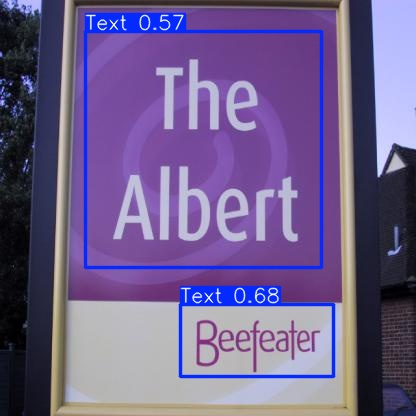

In [ ]:
Image.open("/Users/oliviasteed//runs/detect/predict11/131_jpg.rf.763bd19306a14361c61fa89d88441f6f.jpg")

In [ ]:
model("/Users/oliviasteed/Desktop/Text Dataset/images/test/img_10_jpg.rf.b4d88aca0484d27432a317b796b5e28e.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/Text Dataset/images/test/img_10_jpg.rf.b4d88aca0484d27432a317b796b5e28e.jpg: 640x640 3 Texts, 451.1ms
Speed: 18.4ms preprocess, 451.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict11


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Text'}
 obb: None
 orig_img: array([[[153, 149, 130],
         [151, 147, 128],
         [149, 145, 126],
         ...,
         [151, 144, 125],
         [150, 143, 124],
         [150, 143, 124]],
 
        [[153, 149, 130],
         [151, 147, 128],
         [150, 146, 127],
         ...,
         [151, 144, 125],
         [150, 143, 124],
         [150, 143, 124]],
 
        [[152, 148, 129],
         [151, 147, 128],
         [150, 146, 127],
         ...,
         [151, 144, 125],
         [150, 143, 124],
         [150, 143, 124]],
 
        ...,
 
        [[123, 119, 101],
         [122, 118, 100],
         [117, 113,  95],
         ...,
         [ 21,  13,   6],
         [ 21,  13,   6],
         [ 21,  13,   6]],
 
        [[123, 119, 101],
         [121, 117,  99],
         [117, 113,  95],
         ...,
         [ 21,  13, 

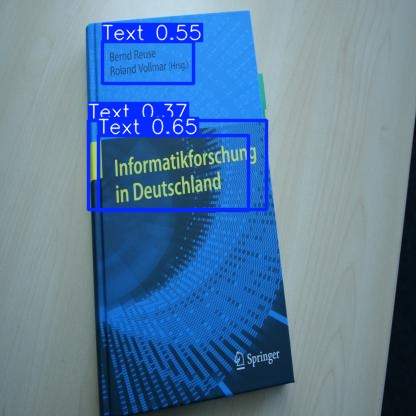

In [ ]:
Image.open("/Users/oliviasteed//runs/detect/predict11/img_10_jpg.rf.b4d88aca0484d27432a317b796b5e28e.jpg")

Slightly more accurate - it catches the text it missed last time.

#### i. A bunch more testing on the variety of data in the combined dataset:

In [ ]:
# test model with test data

model("/Users/oliviasteed/Desktop/Text Dataset/images/test/155_jpg.rf.d4e4cbd876dfc69f09f1361c21eab6c2.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/Text Dataset/images/test/155_jpg.rf.d4e4cbd876dfc69f09f1361c21eab6c2.jpg: 640x640 1 Text, 647.1ms
Speed: 13.6ms preprocess, 647.1ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict3


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Text'}
 obb: None
 orig_img: array([[[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [128, 118, 118],
         [128, 118, 118],
         [128, 118, 118]],
 
        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [128, 118, 118],
         [128, 118, 118],
         [128, 118, 118]],
 
        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [128, 118, 118],
         [128, 118, 118],
         [128, 118, 118]],
 
        ...,
 
        [[  7,   0,   6],
         [  7,   0,   6],
         [  6,   0,   5],
         ...,
         [ 11,  10,  12],
         [ 11,  10,  12],
         [ 11,  10,  12]],
 
        [[  7,   0,   6],
         [  7,   0,   6],
         [  6,   0,   5],
         ...,
         [ 12,  11, 

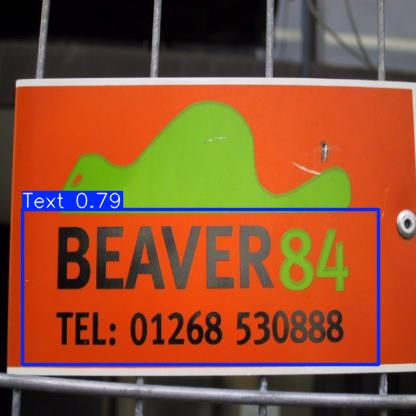

In [ ]:
# show prediction
Image.open('/Users/oliviasteed/runs/detect/predict3/155_jpg.rf.d4e4cbd876dfc69f09f1361c21eab6c2.jpg')

In [ ]:
# test on test data

model("/Users/oliviasteed/Desktop/Text Dataset/images/test/247_jpg.rf.5461f352ec6e9688c685cff96665a0aa.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/Text Dataset/images/test/247_jpg.rf.5461f352ec6e9688c685cff96665a0aa.jpg: 640x640 5 Texts, 442.9ms
Speed: 21.5ms preprocess, 442.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict3


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Text'}
 obb: None
 orig_img: array([[[132,  80,  44],
         [133,  81,  45],
         [133,  81,  45],
         ...,
         [113,  68,  34],
         [113,  68,  34],
         [113,  68,  34]],
 
        [[131,  79,  43],
         [132,  80,  44],
         [132,  80,  44],
         ...,
         [114,  69,  35],
         [113,  68,  34],
         [113,  68,  34]],
 
        [[130,  78,  42],
         [131,  79,  43],
         [132,  80,  44],
         ...,
         [114,  69,  36],
         [114,  69,  36],
         [113,  68,  35]],
 
        ...,
 
        [[113,  66,  39],
         [113,  66,  39],
         [112,  65,  38],
         ...,
         [ 99,  59,  34],
         [ 99,  59,  34],
         [ 98,  58,  33]],
 
        [[112,  65,  38],
         [112,  65,  38],
         [111,  64,  37],
         ...,
         [ 99,  59, 

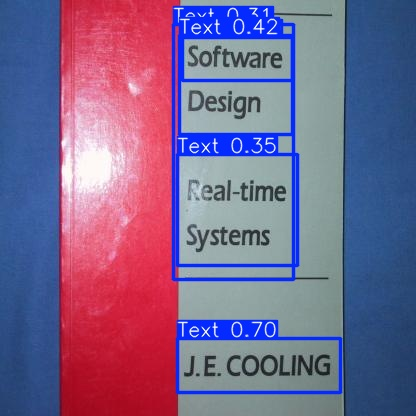

In [ ]:
Image.open('/Users/oliviasteed/runs/detect/predict3/247_jpg.rf.5461f352ec6e9688c685cff96665a0aa.jpg')

In [ ]:
# test on test image
model("/Users/oliviasteed/Desktop/Text Dataset/images/test/Ar_26_An_26_TNR_26_Image199_jpg.rf.fe1402471423e1f6c51ae59e3020c1d3.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/Text Dataset/images/test/Ar_26_An_26_TNR_26_Image199_jpg.rf.fe1402471423e1f6c51ae59e3020c1d3.jpg: 640x640 3 Texts, 277.7ms
Speed: 7.5ms preprocess, 277.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict3


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Text'}
 obb: None
 orig_img: array([[[251, 254, 238],
         [251, 254, 238],
         [251, 254, 239],
         ...,
         [255, 226, 191],
         [255, 226, 191],
         [255, 226, 191]],
 
        [[251, 254, 238],
         [251, 254, 238],
         [252, 255, 240],
         ...,
         [255, 226, 191],
         [255, 226, 191],
         [255, 226, 191]],
 
        [[251, 254, 239],
         [252, 255, 240],
         [252, 255, 240],
         ...,
         [255, 225, 192],
         [255, 226, 193],
         [255, 226, 193]],
 
        ...,
 
        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [124, 115, 106],
         [126, 116, 109],
         [122, 113, 104]],
 
        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [126, 116, 

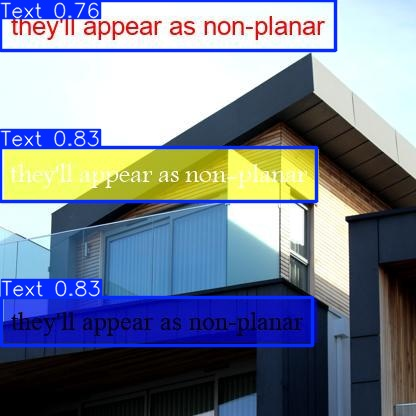

In [ ]:
Image.open('/Users/oliviasteed/runs/detect/predict3/Ar_26_An_26_TNR_26_Image199_jpg.rf.fe1402471423e1f6c51ae59e3020c1d3.jpg')

In [ ]:
# test on test image
model("/Users/oliviasteed/Desktop/Text Dataset/images/test/66_png.rf.0c3431b7e21b2e8076ce3450db980dd8.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/Text Dataset/images/test/66_png.rf.0c3431b7e21b2e8076ce3450db980dd8.jpg: 640x640 4 Texts, 339.5ms
Speed: 6.1ms preprocess, 339.5ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict3


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Text'}
 obb: None
 orig_img: array([[[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        ...,
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 

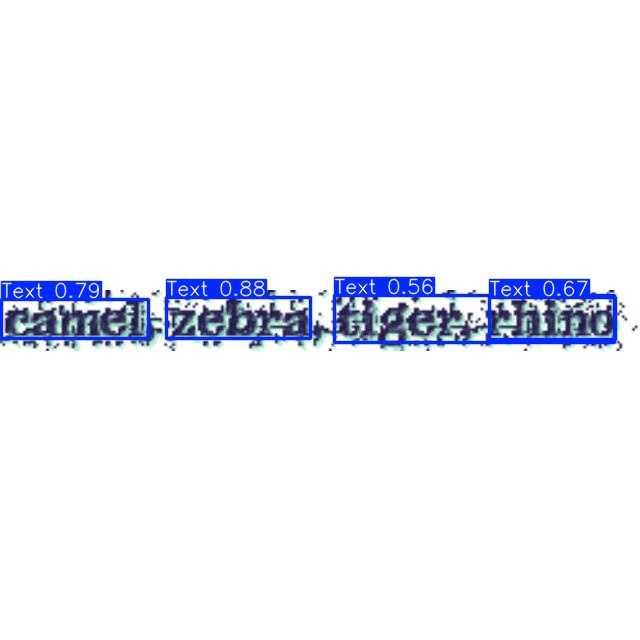

In [ ]:
Image.open('/Users/oliviasteed/runs/detect/predict3/66_png.rf.0c3431b7e21b2e8076ce3450db980dd8.jpg')

#### ii. Testing on my own writing

In [ ]:
# test on image of writing I did

model("/Users/oliviasteed/Desktop/IMG_9534.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/IMG_9534.jpg: 288x640 1 Text, 200.8ms
Speed: 3.5ms preprocess, 200.8ms inference, 1.9ms postprocess per image at shape (1, 3, 288, 640)
Results saved to runs/detect/predict3


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Text'}
 obb: None
 orig_img: array([[[170, 176, 175],
         [167, 173, 172],
         [164, 170, 169],
         ...,
         [165, 171, 170],
         [164, 170, 169],
         [163, 169, 168]],
 
        [[170, 176, 175],
         [167, 173, 172],
         [164, 170, 169],
         ...,
         [165, 171, 170],
         [164, 170, 169],
         [163, 169, 168]],
 
        [[170, 176, 175],
         [167, 173, 172],
         [164, 170, 169],
         ...,
         [165, 171, 170],
         [164, 170, 169],
         [163, 169, 168]],
 
        ...,
 
        [[155, 161, 160],
         [158, 164, 163],
         [162, 168, 167],
         ...,
         [162, 168, 167],
         [163, 169, 168],
         [164, 170, 169]],
 
        [[152, 158, 157],
         [155, 161, 160],
         [160, 166, 165],
         ...,
         [157, 163, 

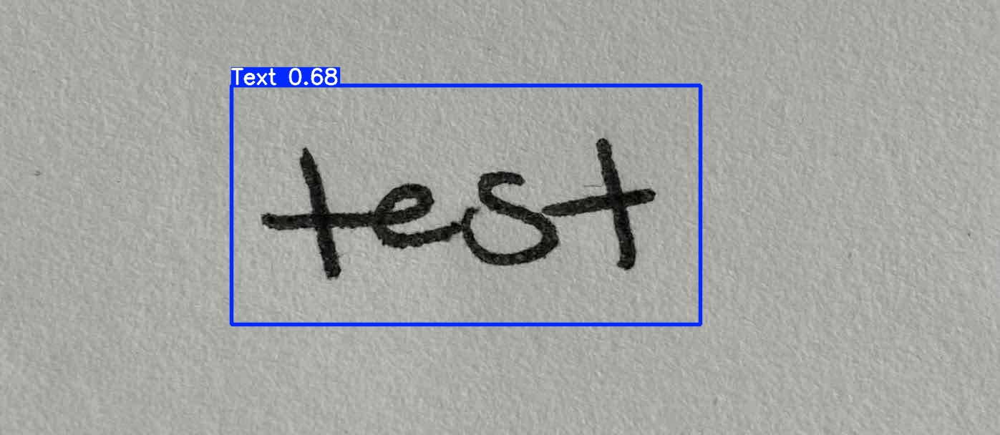

In [ ]:
Image.open('/Users/oliviasteed/runs/detect/predict3/IMG_9534.jpg')

It works!

### E. Crop image around text bounding box

To detect letters, we only want to pass in text bounding box, so we will crop it around text bounding boxes.

In [ ]:
# get prediction on image to test cropping to bounding box

results = model("/Users/oliviasteed/Desktop/IMG_9534.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/IMG_9534.jpg: 288x640 1 Text, 312.0ms
Speed: 2.5ms preprocess, 312.0ms inference, 4.3ms postprocess per image at shape (1, 3, 288, 640)
Results saved to runs/detect/predict11


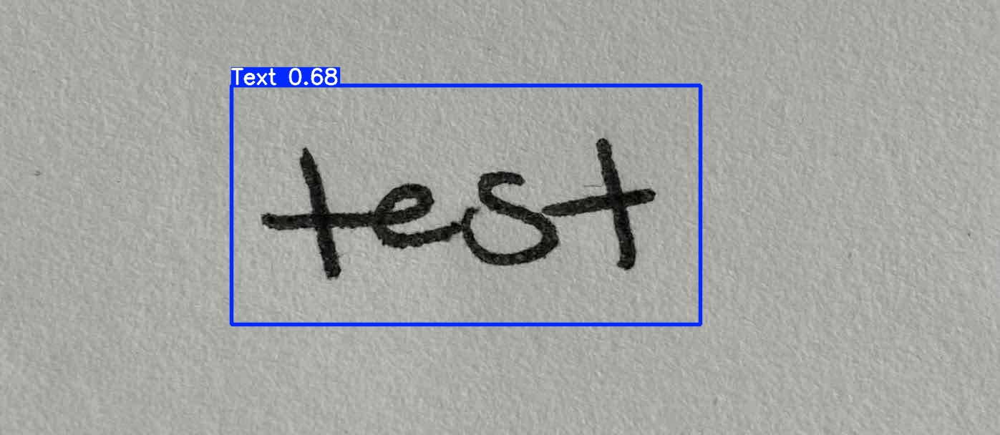

In [ ]:
# check bounding box on original image
Image.open("/Users/oliviasteed/runs/detect/predict11/IMG_9534.jpg")

In [ ]:
# function to crop image to bounding box

# used these as references for getting bounding box and saving to new image
# https://medium.com/@miramnair/yolov7-calculating-the-bounding-box-coordinates-8bab54b97924#:~:text=In%20Yolo%2C%20the%20bounding%20box,centre%20of%20the%20bounding%20box.
# https://github.com/ultralytics/ultralytics/issues/2143

def predict_object_detection(model_results, og_image_path):

  for result in model_results[0].boxes.xyxy:  # Iterate through detected objects
    x_min, y_min, x_max, y_max = result.tolist()

  # load predicted test image
  # image = cv2.imread(output_path)
  image = cv2.imread(og_image_path)

  box_width = int(x_max - x_min)
  box_height = int(y_max - y_min)

  # print(box_width,",",box_height)

  crop = image[int(y_min):int(y_max), int(x_min):int(x_max)]
  cv2.imwrite(og_image_path +"textcrop.jpg", crop)

In [ ]:
predict_object_detection(results, "/Users/oliviasteed/Desktop/IMG_9534.jpg")

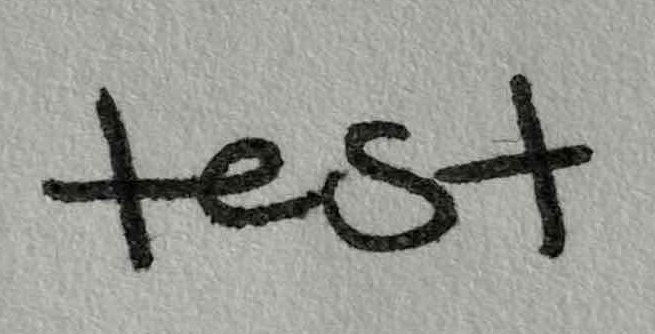

In [ ]:
# check cropped image
Image.open("/Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg")

Now image is cropped only to text and is ready for letter detection.

# 2. Letters Detection

Identifying the letters in cropped text images and printing it out into console.

### A. Data preprocessing

Datasets: three datasets with images/screenshots of text with labeled bounding boxes around each letter.

https://universe.roboflow.com/yolo-3ovhz/letters-xsg2w

https://universe.roboflow.com/arturs-jelagins-a8sef/supercaptcha

https://universe.roboflow.com/adhdob/new-captcha-k3rsn/dataset/5

Draw label bounding box around train data to test it is accurate. I know there is not unlabeled data since I recopied it into the folders myself.

In [ ]:
# showing label - to check if it is labeled right (it is)
%matplotlib inline
from PIL import Image

def draw_yolo_bbox(image_path, label_path):
    # Load image
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    height, width, _ = image.shape

    # Read label file
    with open(label_path, 'r') as file:
        bboxes = file.readlines()

    # Draw each bbox
    for bbox in bboxes:
        class_id, x_center, y_center, bbox_width, bbox_height = [float(x) for x in bbox.split()]

        # Convert YOLO bbox format to rectangle coordinates
        x1 = int((x_center - bbox_width / 2) * width)
        y1 = int((y_center - bbox_height / 2) * height)
        x2 = int((x_center + bbox_width / 2) * width)
        y2 = int((y_center + bbox_height / 2) * height)

        # Draw rectangle
        cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 2)
        # Put label (class_id) near the bbox
        # label = class_labels[int(class_id)]
        label = "text"
        cv2.putText(image, label, (x1, y1+20), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,0,0), 2)
    # Display image
    plt.imshow(image)
    # Image.open(image)
    plt.axis('off')
    plt.savefig('test.jpg')
    return

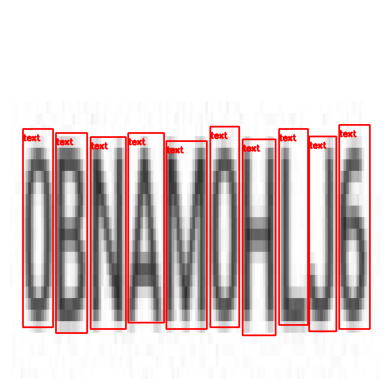

In [ ]:
# letters dataset
draw_yolo_bbox("/Users/oliviasteed/Desktop/Letters Dataset/Letters/train/images/0BNAM0HLJ6_60_jpg.rf.0179b09882f2df2fe9b04b9d6fd6da7f.jpg", "/Users/oliviasteed/Desktop/Letters Dataset/Letters/train/labels/0BNAM0HLJ6_60_jpg.rf.0179b09882f2df2fe9b04b9d6fd6da7f.txt")

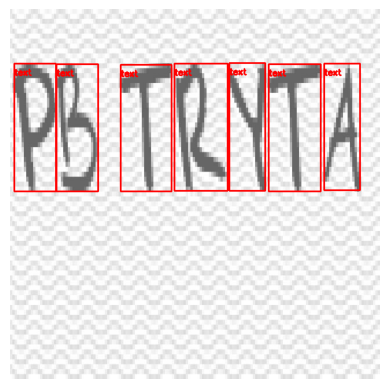

In [ ]:
# super captcha dataset
draw_yolo_bbox("/Users/oliviasteed/Desktop/Letters Dataset/SuperCaptcha/train/images/acaptchaacaptcha_php__CAPTCHA-t_0_00307400_1694268892_png.rf.b23f7eedc228c5d7da5a5e6a1ddfb221.jpg", "/Users/oliviasteed/Desktop/Letters Dataset/SuperCaptcha/train/labels/acaptchaacaptcha_php__CAPTCHA-t_0_00307400_1694268892_png.rf.b23f7eedc228c5d7da5a5e6a1ddfb221.txt")

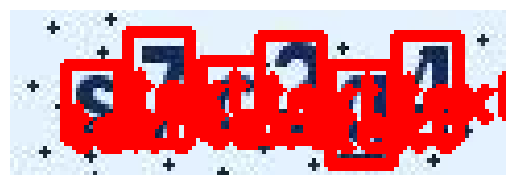

In [ ]:
# new captcha dataset
draw_yolo_bbox("/Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/train/images/0a2c9217-captcha_code_file107_png.rf.0ff86efb8063619765c3fcd0c4d382ac.jpg", "/Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/train/labels/0a2c9217-captcha_code_file107_png.rf.0ff86efb8063619765c3fcd0c4d382ac.txt")

### B. Fine-tune Model for Letter Detection

All datasets look to have accurate labels, so we can train model. I am doing three rounds of training with the three different datasets since they have different class numbers, so combining them results in labeling errors.

In [ ]:
# train new model for letter detection based on previous text tuned model
model2 = YOLO("yolov8n.yaml").load("/Users/oliviasteed/runs/detect/train3/weights/best.pt")

# train model with labeled letter data first
result2 = model2.train(data="/Users/oliviasteed/Desktop/Letters Dataset/Letters/data.yaml", epochs=8, patience=5, batch=8, lr0=0.0005)


Transferred 319/355 items from pretrained weights
New https://pypi.org/project/ultralytics/8.3.25 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.yaml, data=/Users/oliviasteed/Desktop/Letters Dataset/Letters/data.yaml, epochs=8, time=None, patience=5, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train10, exist_ok=False, pretrained=/Users/oliviasteed/runs/detect/train3/weights/best.pt, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_

train: Scanning /Users/oliviasteed/Desktop/Letters Dataset/Letters/train/labels.
val: Scanning /Users/oliviasteed/Desktop/Letters Dataset/Letters/valid/labels.ca


Plotting labels to runs/detect/train10/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0005' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000357, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train10
Starting training for 8 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/8         0G      3.628      4.723      3.196        151        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         57        500          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/8         0G      2.793      4.499      2.376        124        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         57        500          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/8         0G      2.382      4.311      2.047        105        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         57        500    0.00897      0.322     0.0136    0.00503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/8         0G      2.129      4.172      1.873        169        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         57        500     0.0553      0.514     0.0473     0.0321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/8         0G      1.941       4.03      1.765        146        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         57        500     0.0646      0.586     0.0605     0.0267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        6/8         0G      1.797      3.911      1.671         90        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         57        500     0.0255      0.612     0.0491     0.0256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        7/8         0G       1.76      3.825      1.673         98        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         57        500     0.0245      0.631     0.0513     0.0284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        8/8         0G      1.735      3.792      1.641        145        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         57        500     0.0214      0.656      0.054     0.0301



8 epochs completed in 0.466 hours.
Optimizer stripped from runs/detect/train10/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train10/weights/best.pt, 6.3MB

Validating runs/detect/train10/weights/best.pt...
WARNING ⚠️ validating an untrained model YAML will result in 0 mAP.
Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
YOLOv8n summary (fused): 168 layers, 3,010,328 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         57        500     0.0554      0.516     0.0473      0.032
                     .         13         18          0          0          0          0
                     0         14         19     0.0237      0.368     0.0273     0.0124
                     1         13         14    0.00824      0.571     0.0154    0.00613
                     2         16         19     0.0126      0.842     0.0224    0.00881
                     5         23         25     0.0181       0.68     0.0159    0.00588
                     6         21         26          0          0          0          0
                     8         14         18          1     0.0556      0.528      0.475
                     A         20         24     0.0355      0.417     0.0363     0.0168
                     B         12         15     0.0121          1     0.0364     0.0154
                     C         13         14    0.00968          1     0.0192    0.00845
                     

In [ ]:
# validate model
metrics2 = model2.val() # general validation

metrics2.box.map    # map50-95
metrics2.box.mp    # P
metrics2.box.mr    # R

Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)


val: Scanning /Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/valid/labels
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all          8         44      0.631      0.791      0.786      0.488
                     1          1          1      0.681          1      0.995      0.796
                     2          4          5      0.667        0.8      0.906      0.607
                     3          1          1      0.244          1      0.995      0.298
                     6          2          2      0.247        0.5      0.373      0.199
                     7          1          1      0.238          1      0.249      0.199
                     8          3          3      0.444          1      0.995      0.642
                     9          2          2      0.517          1      0.995      0.673
                     C          1          1          1          0     0.0255     0.0153
                     D          1          1       0.65          1      0.995      0.697
                     E          1          1      0.788          1      0.995      0.708
                     

0.7914880423670848

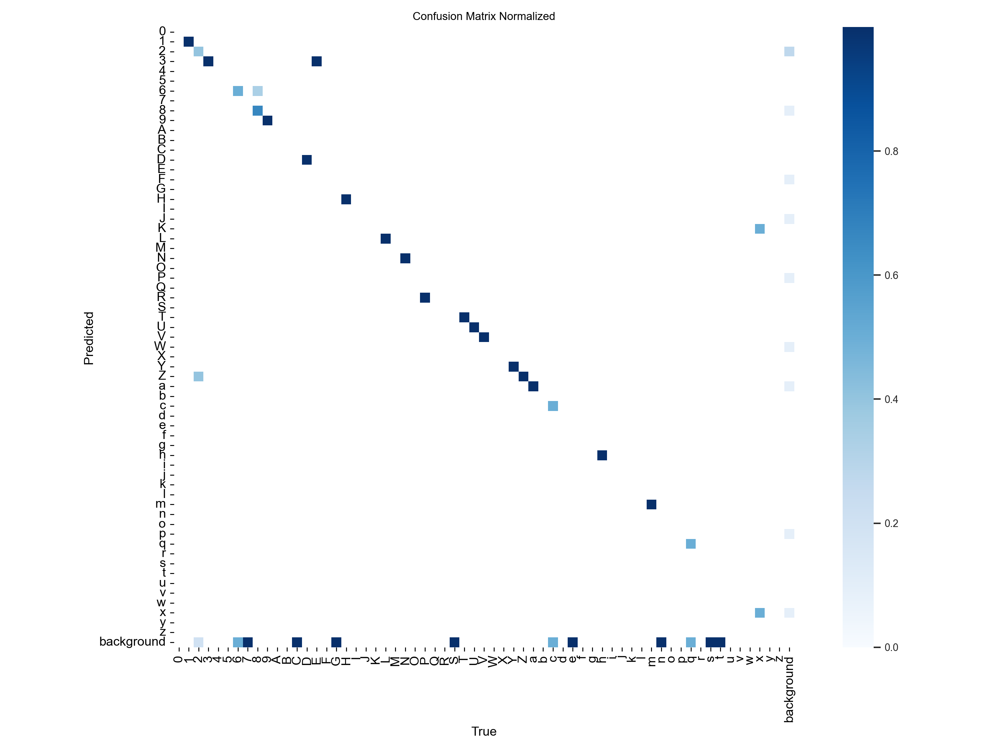

In [ ]:
# show confusion matrix
Image.open("/Users/oliviasteed/runs/detect/val12/confusion_matrix_normalized.png")

In [ ]:
# test model trained on one dataset

model2("/Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg: 352x640 1 5, 1 S, 300.3ms
Speed: 9.3ms preprocess, 300.3ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Results saved to runs/detect/predict6


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: '0', 1: '1', 2: '2', 3: '3', 4: '4', 5: '5', 6: '6', 7: '7', 8: '8', 9: '9', 10: 'A', 11: 'B', 12: 'C', 13: 'D', 14: 'E', 15: 'F', 16: 'G', 17: 'H', 18: 'I', 19: 'J', 20: 'K', 21: 'L', 22: 'M', 23: 'N', 24: 'O', 25: 'P', 26: 'Q', 27: 'R', 28: 'S', 29: 'T', 30: 'U', 31: 'V', 32: 'W', 33: 'X', 34: 'Y', 35: 'Z', 36: 'a', 37: 'b', 38: 'c', 39: 'd', 40: 'e', 41: 'f', 42: 'g', 43: 'h', 44: 'i', 45: 'j', 46: 'k', 47: 'l', 48: 'm', 49: 'n', 50: 'o', 51: 'p', 52: 'q', 53: 'r', 54: 's', 55: 't', 56: 'u', 57: 'v', 58: 'w', 59: 'x', 60: 'y', 61: 'z'}
 obb: None
 orig_img: array([[[165, 171, 170],
         [171, 177, 176],
         [173, 179, 178],
         ...,
         [159, 165, 164],
         [147, 153, 152],
         [154, 160, 159]],
 
        [[158, 164, 163],
         [161, 167, 166],
         [163, 169, 168],
         ...,
         [173, 17

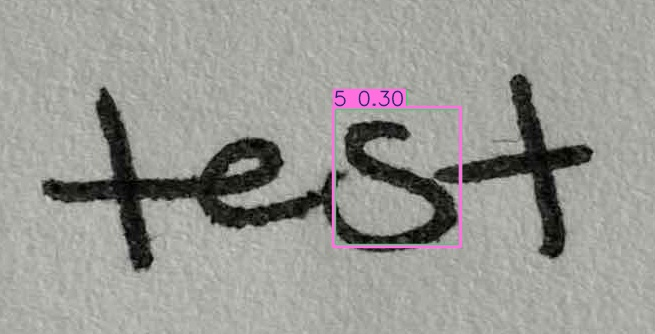

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict6/IMG_9534.jpgtextcrop.jpg")

In [ ]:
# When I open model2 from file it does not detect anything for the same image??

model2_best = YOLO("/Users/oliviasteed/runs/detect/train10/weights/best.pt")
model2_last = YOLO("/Users/oliviasteed/runs/detect/train10/weights/last.pt")

In [ ]:
model2_best("/Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg: 352x640 (no detections), 221.4ms
Speed: 6.1ms preprocess, 221.4ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)
Results saved to runs/detect/predict20


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: '.', 1: '0', 2: '1', 3: '2', 4: '5', 5: '6', 6: '8', 7: 'A', 8: 'B', 9: 'C', 10: 'D', 11: 'E', 12: 'G', 13: 'H', 14: 'I', 15: 'J', 16: 'K', 17: 'L', 18: 'M', 19: 'N', 20: 'O', 21: 'S', 22: 'T', 23: 'U'}
 obb: None
 orig_img: array([[[165, 171, 170],
         [171, 177, 176],
         [173, 179, 178],
         ...,
         [159, 165, 164],
         [147, 153, 152],
         [154, 160, 159]],
 
        [[158, 164, 163],
         [161, 167, 166],
         [163, 169, 168],
         ...,
         [173, 179, 178],
         [159, 165, 164],
         [161, 167, 166]],
 
        [[160, 166, 165],
         [159, 165, 164],
         [159, 165, 164],
         ...,
         [173, 179, 178],
         [158, 164, 163],
         [159, 165, 164]],
 
        ...,
 
        [[162, 168, 167],
         [161, 167, 166],
         [159, 165, 164],
         ...

In [ ]:
model2_last("/Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg: 352x640 (no detections), 245.0ms
Speed: 4.9ms preprocess, 245.0ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)
Results saved to runs/detect/predict21


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: '.', 1: '0', 2: '1', 3: '2', 4: '5', 5: '6', 6: '8', 7: 'A', 8: 'B', 9: 'C', 10: 'D', 11: 'E', 12: 'G', 13: 'H', 14: 'I', 15: 'J', 16: 'K', 17: 'L', 18: 'M', 19: 'N', 20: 'O', 21: 'S', 22: 'T', 23: 'U'}
 obb: None
 orig_img: array([[[165, 171, 170],
         [171, 177, 176],
         [173, 179, 178],
         ...,
         [159, 165, 164],
         [147, 153, 152],
         [154, 160, 159]],
 
        [[158, 164, 163],
         [161, 167, 166],
         [163, 169, 168],
         ...,
         [173, 179, 178],
         [159, 165, 164],
         [161, 167, 166]],
 
        [[160, 166, 165],
         [159, 165, 164],
         [159, 165, 164],
         ...,
         [173, 179, 178],
         [158, 164, 163],
         [159, 165, 164]],
 
        ...,
 
        [[162, 168, 167],
         [161, 167, 166],
         [159, 165, 164],
         ...

I am not sure why but the model2 referred to from training is not the same as the best or last version of the model.

In [ ]:
model2.info()

YOLOv8n summary (fused): 168 layers, 3,017,738 parameters, 0 gradients, 8.2 GFLOPs


(168, 3017738, 0, 8.150784)

In [ ]:
model2_best.info()

YOLOv8n summary (fused): 168 layers, 3,010,328 parameters, 0 gradients, 8.1 GFLOPs


(168, 3010328, 0, 8.1099264)

In [ ]:
model2_last.info()

YOLOv8n summary (fused): 168 layers, 3,010,328 parameters, 0 gradients, 8.1 GFLOPs


(168, 3010328, 0, 8.1099264)

Saving model from model2 to get best model so far for reuse/continued.training.

In [ ]:
!pip3 install onnx
!pip3 install onnxruntime

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.7/16.7 MB 47.7 MB/s eta 0:00:00

[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: pip3 install --upgrade pip
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.8/16.8 MB 29.6 MB/s eta 0:00:00

[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: pip3 install --upgrade pip


In [ ]:
model2.export(format="onnx")

Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)

PyTorch: starting from '/Users/oliviasteed/runs/detect/train11/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 66, 8400) (6.0 MB)
requirements: Ultralytics requirement ['onnxslim'] not found, attempting AutoUpdate...
Retry 1/2 failed: Command 'pip install --no-cache-dir "onnxslim" ' returned non-zero exit status 127.


/bin/sh: pip: command not found


Retry 2/2 failed: Command 'pip install --no-cache-dir "onnxslim" ' returned non-zero exit status 127.
requirements: ❌ Command 'pip install --no-cache-dir "onnxslim" ' returned non-zero exit status 127.


/bin/sh: pip: command not found



ONNX: starting export with onnx 1.17.0 opset 17...
ONNX: simplifier failure: No module named 'onnxslim'
ONNX: export success ✅ 6.1s, saved as '/Users/oliviasteed/runs/detect/train11/weights/best.onnx' (11.7 MB)

Export complete (8.0s)
Results saved to /Users/oliviasteed/runs/detect/train11/weights
Predict:         yolo predict task=detect model=/Users/oliviasteed/runs/detect/train11/weights/best.onnx imgsz=640  
Validate:        yolo val task=detect model=/Users/oliviasteed/runs/detect/train11/weights/best.onnx imgsz=640 data=/Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/data.yaml  
Visualize:       https://netron.app


'/Users/oliviasteed/runs/detect/train11/weights/best.onnx'

In [ ]:
model2_saved = YOLO("/Users/oliviasteed/runs/detect/train11/weights/best.onnx")

In [ ]:
model2_saved("/Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg: 640x640 1 e, 260.8ms
Speed: 12.1ms preprocess, 260.8ms inference, 9.1ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict22


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: '0', 1: '1', 2: '2', 3: '3', 4: '4', 5: '5', 6: '6', 7: '7', 8: '8', 9: '9', 10: 'A', 11: 'B', 12: 'C', 13: 'D', 14: 'E', 15: 'F', 16: 'G', 17: 'H', 18: 'I', 19: 'J', 20: 'K', 21: 'L', 22: 'M', 23: 'N', 24: 'O', 25: 'P', 26: 'Q', 27: 'R', 28: 'S', 29: 'T', 30: 'U', 31: 'V', 32: 'W', 33: 'X', 34: 'Y', 35: 'Z', 36: 'a', 37: 'b', 38: 'c', 39: 'd', 40: 'e', 41: 'f', 42: 'g', 43: 'h', 44: 'i', 45: 'j', 46: 'k', 47: 'l', 48: 'm', 49: 'n', 50: 'o', 51: 'p', 52: 'q', 53: 'r', 54: 's', 55: 't', 56: 'u', 57: 'v', 58: 'w', 59: 'x', 60: 'y', 61: 'z'}
 obb: None
 orig_img: array([[[165, 171, 170],
         [171, 177, 176],
         [173, 179, 178],
         ...,
         [159, 165, 164],
         [147, 153, 152],
         [154, 160, 159]],
 
        [[158, 164, 163],
         [161, 167, 166],
         [163, 169, 168],
         ...,
         [173, 17

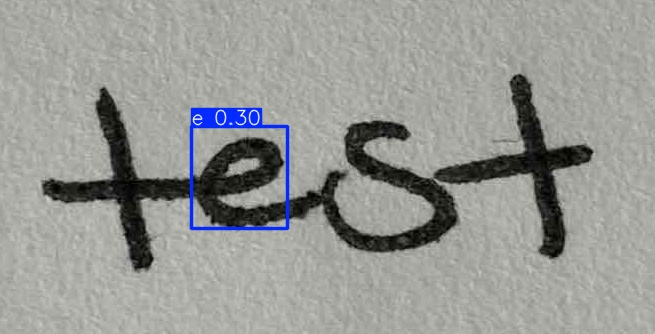

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict22/IMG_9534.jpgtextcrop.jpg")

When I save and then reload the model, it identifies a different letter? (E instead of S).

#### Changing Learning Rate
Because of generally pretty low accuracy, I am going to try training it again with a higher learning rate (of 0.01) so it learns faster.

In [ ]:
# train model with super captcha data
model_2 = YOLO("yolov8n.yaml")

In [ ]:
result_2 = model_2.train(data="/Users/oliviasteed/Desktop/Letters Dataset/Letters/data.yaml", epochs=8, patience=5, batch=8, lr0=0.01)

New https://pypi.org/project/ultralytics/8.3.27 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.yaml, data=/Users/oliviasteed/Desktop/Letters Dataset/Letters/data.yaml, epochs=8, time=None, patience=5, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train17, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False,

train: Scanning /Users/oliviasteed/Desktop/Letters Dataset/Letters/train/labels.
val: Scanning /Users/oliviasteed/Desktop/Letters Dataset/Letters/valid/labels.ca

Plotting labels to runs/detect/train17/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000357, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train17
Starting training for 8 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/8         0G      5.225      5.248      4.289        139        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         57        500          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/8         0G      5.192      5.197        4.2        117        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         57        500          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/8         0G       5.22      5.113      4.061        144        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         57        500          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/8         0G      4.969      5.045      3.962        114        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         57        500          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/8         0G       4.83      4.968      3.877        124        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         57        500          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        6/8         0G      4.754      4.936      3.822        137        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         57        500          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        7/8         0G      4.681      4.901      3.792        167        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         57        500          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        8/8         0G      4.649      4.882      3.746        168        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         57        500   0.000777    0.00438   0.000423   4.23e-05



8 epochs completed in 0.485 hours.
Optimizer stripped from runs/detect/train17/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train17/weights/best.pt, 6.3MB

Validating runs/detect/train17/weights/best.pt...
WARNING ⚠️ validating an untrained model YAML will result in 0 mAP.
Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
YOLOv8n summary (fused): 168 layers, 3,010,328 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         57        500   0.000765    0.00438   0.000418   4.18e-05
                     .         13         18          0          0          0          0
                     0         14         19          0          0          0          0
                     1         13         14          0          0          0          0
                     2         16         19          0          0          0          0
                     5         23         25          0          0          0          0
                     6         21         26          0          0          0          0
                     8         14         18          0          0          0          0
                     A         20         24          0          0          0          0
                     B         12         15          0          0          0          0
                     C         13         14          0          0          0          0
                     

In [ ]:
metrics_2 = model_2.val()

metrics_2.box.map    # map50-95
metrics_2.box.mp    # P
metrics_2.box.mr    # R

WARNING ⚠️ validating an untrained model YAML will result in 0 mAP.
Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)


val: Scanning /Users/oliviasteed/Desktop/Letters Dataset/Letters/valid/labels.ca
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         57        500   0.000765    0.00438   0.000418   4.18e-05
                     .         13         18          0          0          0          0
                     0         14         19          0          0          0          0
                     1         13         14          0          0          0          0
                     2         16         19          0          0          0          0
                     5         23         25          0          0          0          0
                     6         21         26          0          0          0          0
                     8         14         18          0          0          0          0
                     A         20         24          0          0          0          0
                     B         12         15          0          0          0          0
                     C         13         14          0          0          0          0
                     

0.00438034188034188

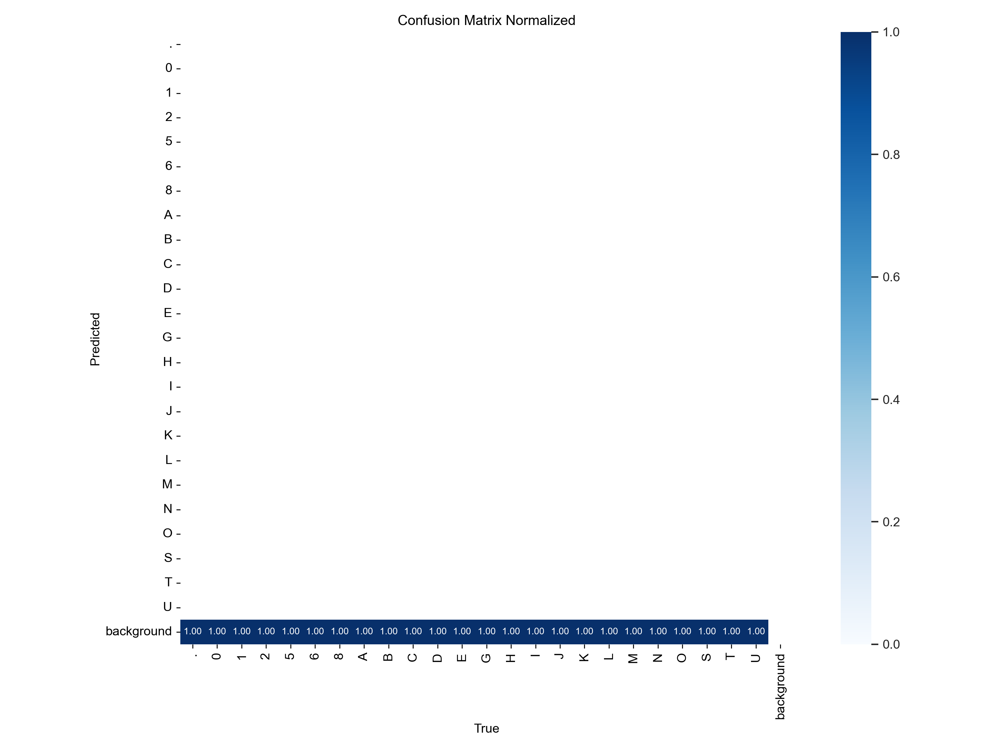

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/train174/confusion_matrix_normalized.png")

In [ ]:
model_2("/Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg: 352x640 (no detections), 257.8ms
Speed: 4.9ms preprocess, 257.8ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)
Results saved to runs/detect/train1710


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: '.', 1: '0', 2: '1', 3: '2', 4: '5', 5: '6', 6: '8', 7: 'A', 8: 'B', 9: 'C', 10: 'D', 11: 'E', 12: 'G', 13: 'H', 14: 'I', 15: 'J', 16: 'K', 17: 'L', 18: 'M', 19: 'N', 20: 'O', 21: 'S', 22: 'T', 23: 'U'}
 obb: None
 orig_img: array([[[165, 171, 170],
         [171, 177, 176],
         [173, 179, 178],
         ...,
         [159, 165, 164],
         [147, 153, 152],
         [154, 160, 159]],
 
        [[158, 164, 163],
         [161, 167, 166],
         [163, 169, 168],
         ...,
         [173, 179, 178],
         [159, 165, 164],
         [161, 167, 166]],
 
        [[160, 166, 165],
         [159, 165, 164],
         [159, 165, 164],
         ...,
         [173, 179, 178],
         [158, 164, 163],
         [159, 165, 164]],
 
        ...,
 
        [[162, 168, 167],
         [161, 167, 166],
         [159, 165, 164],
         ...

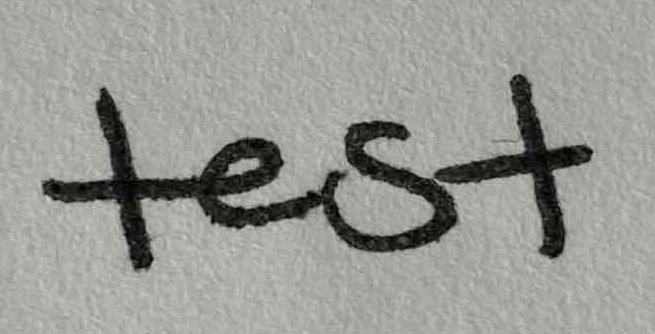

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/train1710/IMG_9534.jpgtextcrop.jpg")

#### That was a fail
Increasing the learning rate made the model perform a lot worse so I will not be using this version.

#### Training letter detection model on more data
To increase generalizability, I am training model2 on handwritten captchas with individual letters labeled.

In [ ]:
# train model with super captcha data

model33 = YOLO("/Users/oliviasteed/runs/detect/train10/weights/best.pt")  # this is the saved model2 path
result33 = model33.train(data="/Users/oliviasteed/Desktop/Letters Dataset/SuperCaptcha/data.yaml", epochs=8, patience=5, batch=8, lr0=0.0005)

New https://pypi.org/project/ultralytics/8.3.27 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
engine/trainer: task=detect, mode=train, model=/Users/oliviasteed/runs/detect/train10/weights/best.pt, data=/Users/oliviasteed/Desktop/Letters Dataset/SuperCaptcha/data.yaml, epochs=8, time=None, patience=5, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train22, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnost

train: Scanning /Users/oliviasteed/Desktop/Letters Dataset/SuperCaptcha/train/la
val: Scanning /Users/oliviasteed/Desktop/Letters Dataset/SuperCaptcha/valid/labe

Plotting labels to runs/detect/train22/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0005' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000204, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train22
Starting training for 8 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/8         0G      2.092      4.941      1.837         11        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all        105        735     0.0063     0.0596     0.0077    0.00267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/8         0G      1.556      4.774      1.452         32        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all        105        735     0.0148      0.137     0.0218     0.0107



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/8         0G      1.327      4.537      1.304         16        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all        105        735     0.0413      0.353     0.0492     0.0257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/8         0G      1.181      4.377       1.21         33        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all        105        735     0.0217       0.57     0.0512     0.0347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/8         0G       1.13      4.239      1.174         20        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all        105        735     0.0199      0.697     0.0647      0.047



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        6/8         0G      1.103      4.125      1.167         19        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all        105        735     0.0221      0.726     0.0748     0.0541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        7/8         0G      1.038      4.074      1.119         15        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all        105        735     0.0236      0.753     0.0832     0.0621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        8/8         0G      1.019      4.019      1.119         42        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all        105        735     0.0242      0.753     0.0899     0.0675



8 epochs completed in 0.535 hours.
Optimizer stripped from runs/detect/train22/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train22/weights/best.pt, 6.3MB

Validating runs/detect/train22/weights/best.pt...
Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
YOLOv8n summary (fused): 168 layers, 3,014,423 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all        105        735     0.0242      0.753     0.0902     0.0677
                     A         15         16     0.0103          1     0.0252     0.0142
                     B         15         16     0.0165          1      0.117     0.0969
                     C         16         17     0.0127          1     0.0451     0.0318
                     D         16         17     0.0181          1      0.357      0.257
                     E         18         19     0.0231          1      0.278      0.234
                     F         14         14    0.00749      0.143    0.00429     0.0028
                     G         19         22     0.0346          1     0.0985     0.0856
                     H         19         20     0.0128          1     0.0522     0.0405
                     J         15         18      0.014          1     0.0231     0.0157
                     K         16         16     0.0173          1      0.137      0.122
                     

In [ ]:
# validate model3
metrics33 = model33.val() # general validation

metrics33.box.map    # map50-95
metrics33.box.mp    # P
metrics33.box.mr    # R

Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
YOLOv8n summary (fused): 168 layers, 3,014,423 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /Users/oliviasteed/Desktop/Letters Dataset/SuperCaptcha/valid/labe
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all        105        735     0.0242      0.753     0.0902     0.0677
                     A         15         16     0.0103          1     0.0252     0.0142
                     B         15         16     0.0165          1      0.117     0.0969
                     C         16         17     0.0127          1     0.0451     0.0318
                     D         16         17     0.0181          1      0.357      0.257
                     E         18         19     0.0231          1      0.278      0.234
                     F         14         14    0.00749      0.143    0.00429     0.0028
                     G         19         22     0.0346          1     0.0985     0.0856
                     H         19         20     0.0128          1     0.0522     0.0405
                     J         15         18      0.014          1     0.0231     0.0157
                     K         16         16     0.0173          1      0.137      0.122
                     

0.75265742211271

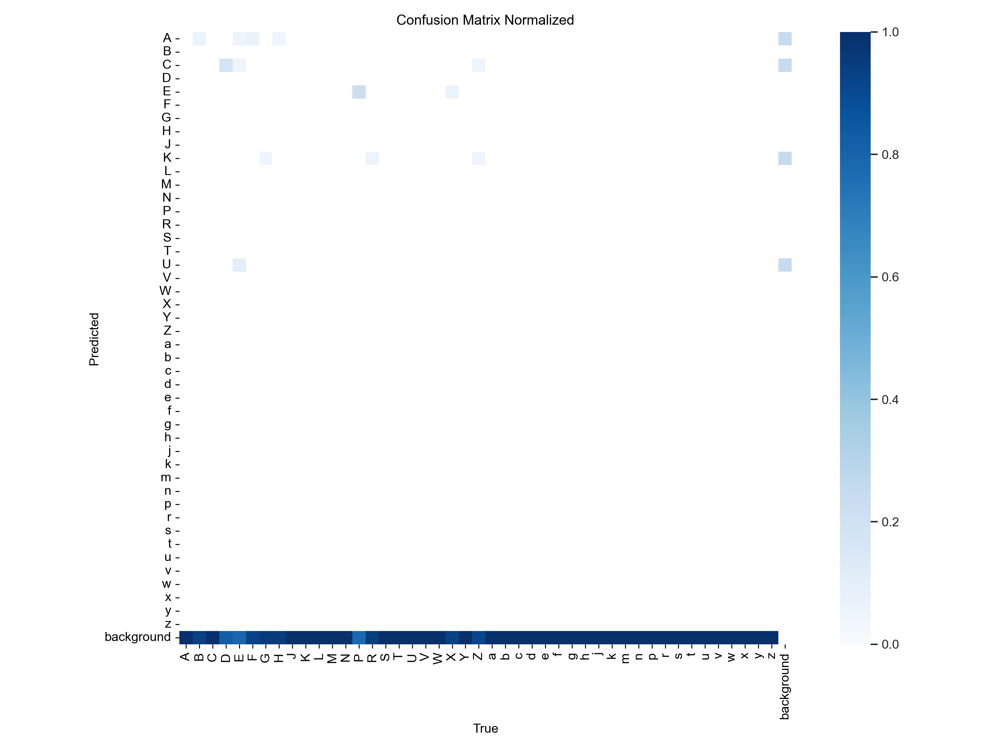

In [ ]:
# show confusion matrix
Image.open("/Users/oliviasteed/runs/detect/train222/confusion_matrix_normalized.png")

In [ ]:
# test model on same image

model33("/Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg: 352x640 (no detections), 229.4ms
Speed: 12.8ms preprocess, 229.4ms inference, 0.8ms postprocess per image at shape (1, 3, 352, 640)
Results saved to runs/detect/train223


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'A', 1: 'B', 2: 'C', 3: 'D', 4: 'E', 5: 'F', 6: 'G', 7: 'H', 8: 'J', 9: 'K', 10: 'L', 11: 'M', 12: 'N', 13: 'P', 14: 'R', 15: 'S', 16: 'T', 17: 'U', 18: 'V', 19: 'W', 20: 'X', 21: 'Y', 22: 'Z', 23: 'a', 24: 'b', 25: 'c', 26: 'd', 27: 'e', 28: 'f', 29: 'g', 30: 'h', 31: 'j', 32: 'k', 33: 'm', 34: 'n', 35: 'p', 36: 'r', 37: 's', 38: 't', 39: 'u', 40: 'v', 41: 'w', 42: 'x', 43: 'y', 44: 'z'}
 obb: None
 orig_img: array([[[165, 171, 170],
         [171, 177, 176],
         [173, 179, 178],
         ...,
         [159, 165, 164],
         [147, 153, 152],
         [154, 160, 159]],
 
        [[158, 164, 163],
         [161, 167, 166],
         [163, 169, 168],
         ...,
         [173, 179, 178],
         [159, 165, 164],
         [161, 167, 166]],
 
        [[160, 166, 165],
         [159, 165, 164],
         [159, 165, 164],
         ..

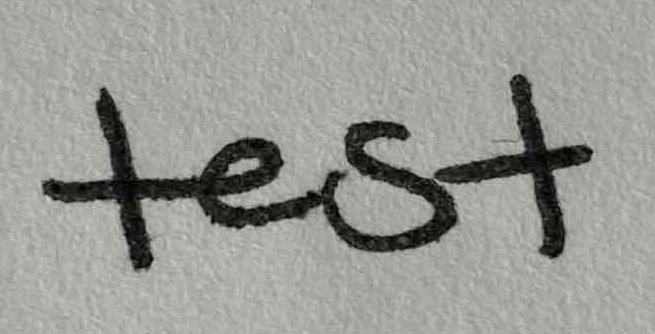

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/train223/IMG_9534.jpgtextcrop.jpg")

Strangely, they are only getting worse when I train them more. This one performs terribly and doesn't detect anything. Let's try another dataset. I initially trained this one with 8 epochs (as seen below) and the result was it didn't work for anything but captcha-style images (because that's what the new captcha dataset contains). I think this was a case of overfitting, so I will be training it with 3 epochs this time to test the difference.

In [ ]:
# trained model with new captcha data - 8 epochs

model4 = YOLO("/Users/oliviasteed/runs/detect/train14/weights/best.pt")  # this is the model path
result4 = model4.train(data="/Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/data.yaml", epochs=8, patience=5, batch=8, lr0=0.0005)

New https://pypi.org/project/ultralytics/8.3.27 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
engine/trainer: task=detect, mode=train, model=/Users/oliviasteed/runs/detect/train102/weights/best.pt, data=/Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/data.yaml, epochs=8, time=None, patience=5, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train11, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnosti

train: Scanning /Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/train/labe
val: Scanning /Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/valid/labels


Plotting labels to runs/detect/train11/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0005' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000152, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train11
Starting training for 8 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/8         0G      1.945      4.547      1.528         34        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all          8         44      0.122      0.348      0.143     0.0824



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/8         0G      1.747      3.793      1.402         29        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all          8         44       0.66      0.273      0.319      0.178



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/8         0G       1.68      3.348      1.405         24        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all          8         44      0.537      0.438      0.489      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/8         0G      1.635      3.011      1.407         32        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all          8         44      0.443      0.582      0.631      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/8         0G      1.601       2.78      1.401         36        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all          8         44      0.588       0.67      0.727      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        6/8         0G      1.576        2.6      1.395         35        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all          8         44      0.563      0.694       0.77      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        7/8         0G      1.554      2.482      1.384         35        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all          8         44      0.673      0.711      0.786      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        8/8         0G      1.533        2.4      1.378         32        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all          8         44      0.632      0.791      0.786      0.488



8 epochs completed in 7.799 hours.
Optimizer stripped from runs/detect/train11/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train11/weights/best.pt, 6.2MB

Validating runs/detect/train11/weights/best.pt...
Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
YOLOv8n summary (fused): 168 layers, 3,017,738 parameters, 0 gradients, 8.2 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all          8         44      0.631      0.791      0.786      0.488
                     1          1          1      0.681          1      0.995      0.796
                     2          4          5      0.667        0.8      0.906      0.607
                     3          1          1      0.244          1      0.995      0.298
                     6          2          2      0.247        0.5      0.373      0.199
                     7          1          1      0.238          1      0.249      0.199
                     8          3          3      0.444          1      0.995      0.642
                     9          2          2      0.517          1      0.995      0.673
                     C          1          1          1          0     0.0255     0.0153
                     D          1          1       0.65          1      0.995      0.697
                     E          1          1      0.788          1      0.995      0.708
                     

In [ ]:
# load up 8 epoch model to validate
model4 = YOLO("/Users/oliviasteed/runs/detect/train11/weights/best.pt")

# validate model
metrics4 = model4.val() # general validation

metrics4.box.map    # map50-95
metrics4.box.mp    # P
metrics4.box.mr    # R

Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
YOLOv8n summary (fused): 168 layers, 3,017,738 parameters, 0 gradients, 8.2 GFLOPs


val: Scanning /Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/valid/labels
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all          8         44      0.631      0.791      0.786      0.488
                     1          1          1      0.681          1      0.995      0.796
                     2          4          5      0.667        0.8      0.906      0.607
                     3          1          1      0.244          1      0.995      0.298
                     6          2          2      0.247        0.5      0.373      0.199
                     7          1          1      0.238          1      0.249      0.199
                     8          3          3      0.444          1      0.995      0.642
                     9          2          2      0.517          1      0.995      0.673
                     C          1          1          1          0     0.0255     0.0153
                     D          1          1       0.65          1      0.995      0.697
                     E          1          1      0.788          1      0.995      0.708
                     

0.7914880423670848

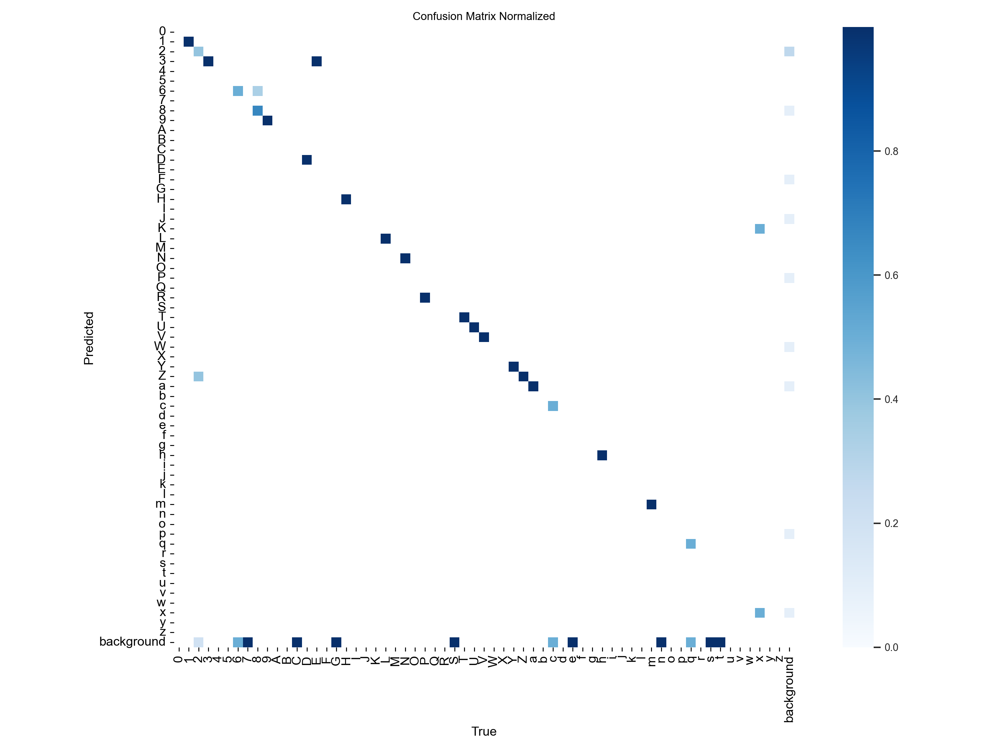

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/val16/confusion_matrix_normalized.png")

In [ ]:
# test model on same image

model4("/Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg: 352x640 1 5, 1 S, 254.7ms
Speed: 7.1ms preprocess, 254.7ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)
Results saved to runs/detect/predict24


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: '0', 1: '1', 2: '2', 3: '3', 4: '4', 5: '5', 6: '6', 7: '7', 8: '8', 9: '9', 10: 'A', 11: 'B', 12: 'C', 13: 'D', 14: 'E', 15: 'F', 16: 'G', 17: 'H', 18: 'I', 19: 'J', 20: 'K', 21: 'L', 22: 'M', 23: 'N', 24: 'O', 25: 'P', 26: 'Q', 27: 'R', 28: 'S', 29: 'T', 30: 'U', 31: 'V', 32: 'W', 33: 'X', 34: 'Y', 35: 'Z', 36: 'a', 37: 'b', 38: 'c', 39: 'd', 40: 'e', 41: 'f', 42: 'g', 43: 'h', 44: 'i', 45: 'j', 46: 'k', 47: 'l', 48: 'm', 49: 'n', 50: 'o', 51: 'p', 52: 'q', 53: 'r', 54: 's', 55: 't', 56: 'u', 57: 'v', 58: 'w', 59: 'x', 60: 'y', 61: 'z'}
 obb: None
 orig_img: array([[[165, 171, 170],
         [171, 177, 176],
         [173, 179, 178],
         ...,
         [159, 165, 164],
         [147, 153, 152],
         [154, 160, 159]],
 
        [[158, 164, 163],
         [161, 167, 166],
         [163, 169, 168],
         ...,
         [173, 17

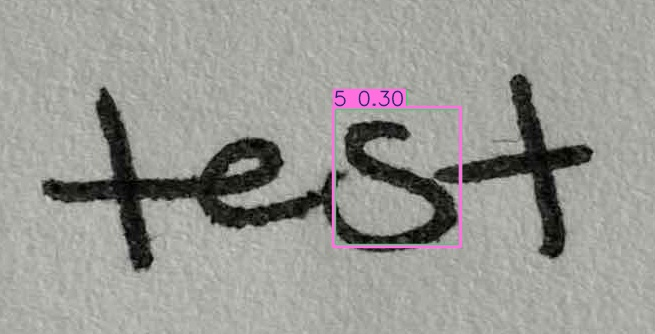

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict12/IMG_9534.jpgtextcrop.jpg")

Performs the same as the initial model (model2) with my test image, but at least it detects something.




In [ ]:
model4("/Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/train/images/0a968549-20download_png.rf.97a45c6684f56bc732970138bda02cb9.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/train/images/0a968549-20download_png.rf.97a45c6684f56bc732970138bda02cb9.jpg: 128x640 1 3, 1 9, 1 T, 1 V, 1 b, 1 j, 161.6ms
Speed: 2.9ms preprocess, 161.6ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 640)
Results saved to runs/detect/predict24


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: '0', 1: '1', 2: '2', 3: '3', 4: '4', 5: '5', 6: '6', 7: '7', 8: '8', 9: '9', 10: 'A', 11: 'B', 12: 'C', 13: 'D', 14: 'E', 15: 'F', 16: 'G', 17: 'H', 18: 'I', 19: 'J', 20: 'K', 21: 'L', 22: 'M', 23: 'N', 24: 'O', 25: 'P', 26: 'Q', 27: 'R', 28: 'S', 29: 'T', 30: 'U', 31: 'V', 32: 'W', 33: 'X', 34: 'Y', 35: 'Z', 36: 'a', 37: 'b', 38: 'c', 39: 'd', 40: 'e', 41: 'f', 42: 'g', 43: 'h', 44: 'i', 45: 'j', 46: 'k', 47: 'l', 48: 'm', 49: 'n', 50: 'o', 51: 'p', 52: 'q', 53: 'r', 54: 's', 55: 't', 56: 'u', 57: 'v', 58: 'w', 59: 'x', 60: 'y', 61: 'z'}
 obb: None
 orig_img: array([[[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 25

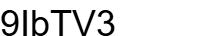

In [ ]:
Image.open("/Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/train/images/0a968549-20download_png.rf.97a45c6684f56bc732970138bda02cb9.jpg")

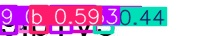

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict24/0a968549-20download_png.rf.97a45c6684f56bc732970138bda02cb9.jpg")

It does pretty well on captcha data which it was mainly trained on, so a possible case of overfitting.

#### i. Training on manually labeled image data to decrease overfitting on captchas

To address possible overfitting with captcha data and underfitting with other data types, I manually labeled the individual letters in 158 images and screenshots of text.

You can see the dataset here: https://universe.roboflow.com/iat360/letters-recognition. The images are sampled from two of the text detection datasets I linked previously.

In [ ]:
# training model with more diverse labeled letter data to address overfitting

model55 = YOLO("/Users/oliviasteed/runs/detect/train11/weights/best.pt")  # loading up model4 best
result55 = model55.train(data="/Users/oliviasteed/Desktop/My Letters Dataset/data.yaml", epochs=8, patience=5, batch=8, lr0=0.0005)

New https://pypi.org/project/ultralytics/8.3.27 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
engine/trainer: task=detect, mode=train, model=/Users/oliviasteed/runs/detect/train11/weights/best.pt, data=/Users/oliviasteed/Desktop/My Letters Dataset/data.yaml, epochs=8, time=None, patience=5, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train23, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=Fal

train: Scanning /Users/oliviasteed/Desktop/My Letters Dataset/train/labels.cache
val: Scanning /Users/oliviasteed/Desktop/My Letters Dataset/valid/labels.cache..

Plotting labels to runs/detect/train23/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0005' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000323, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train23
Starting training for 8 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/8         0G       2.76        4.7      1.756        132        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         32        644     0.0207      0.242     0.0215    0.00866



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/8         0G      2.386       4.49      1.392        170        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         32        644     0.0228       0.28     0.0244    0.00979



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/8         0G      2.261      4.324      1.313        120        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         32        644     0.0241      0.309     0.0342     0.0143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/8         0G      2.139      4.179      1.267        233        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         32        644      0.024      0.319     0.0378     0.0179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/8         0G       2.08      4.014      1.213        111        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         32        644     0.0249      0.331     0.0396      0.019



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        6/8         0G      2.111      3.953      1.198        255        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         32        644     0.0245      0.338     0.0448     0.0214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        7/8         0G      2.059       3.86      1.208        158        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         32        644     0.0255      0.346     0.0461     0.0221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        8/8         0G      2.046      3.783      1.182        214        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         32        644     0.0275      0.368     0.0484     0.0231



8 epochs completed in 0.276 hours.
Optimizer stripped from runs/detect/train23/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train23/weights/best.pt, 6.3MB

Validating runs/detect/train23/weights/best.pt...
Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
YOLOv8n summary (fused): 168 layers, 3,010,913 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         32        644     0.0275      0.368     0.0484      0.023
                     B         11         17     0.0357      0.824     0.0976     0.0513
                     E         29         93     0.0865      0.796     0.0943      0.039
                     F          9         11     0.0219      0.273      0.016     0.0121
                     G          8         11      0.027      0.455     0.0418     0.0241
                     I         21         44     0.0164     0.0455    0.00967    0.00378
                     K          7          8          0          0          0          0
                     L          8         13          0          0          0          0
               Letters          5          8          0          0          0          0
                     Q          1          1          0          0          0          0
                     V          6          9     0.0312      0.222     0.0212     0.0137
                     

In [ ]:
# validate model
metrics55 = model55.val() # general validation

metrics55.box.map    # map50-95
metrics55.box.mp    # P
metrics55.box.mr    # R

Ultralytics 8.3.17 🚀 Python-3.12.6 torch-2.2.2 CPU (Intel Core(TM) i5-5257U 2.70GHz)
YOLOv8n summary (fused): 168 layers, 3,010,913 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /Users/oliviasteed/Desktop/My Letters Dataset/valid/labels.cache..
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         32        644     0.0275      0.368     0.0484      0.023
                     B         11         17     0.0357      0.824     0.0976     0.0513
                     E         29         93     0.0865      0.796     0.0943      0.039
                     F          9         11     0.0219      0.273      0.016     0.0121
                     G          8         11      0.027      0.455     0.0418     0.0241
                     I         21         44     0.0164     0.0455    0.00967    0.00378
                     K          7          8          0          0          0          0
                     L          8         13          0          0          0          0
               Letters          5          8          0          0          0          0
                     Q          1          1          0          0          0          0
                     V          6          9     0.0312      0.222     0.0212     0.0137
                     

0.3677810663479294

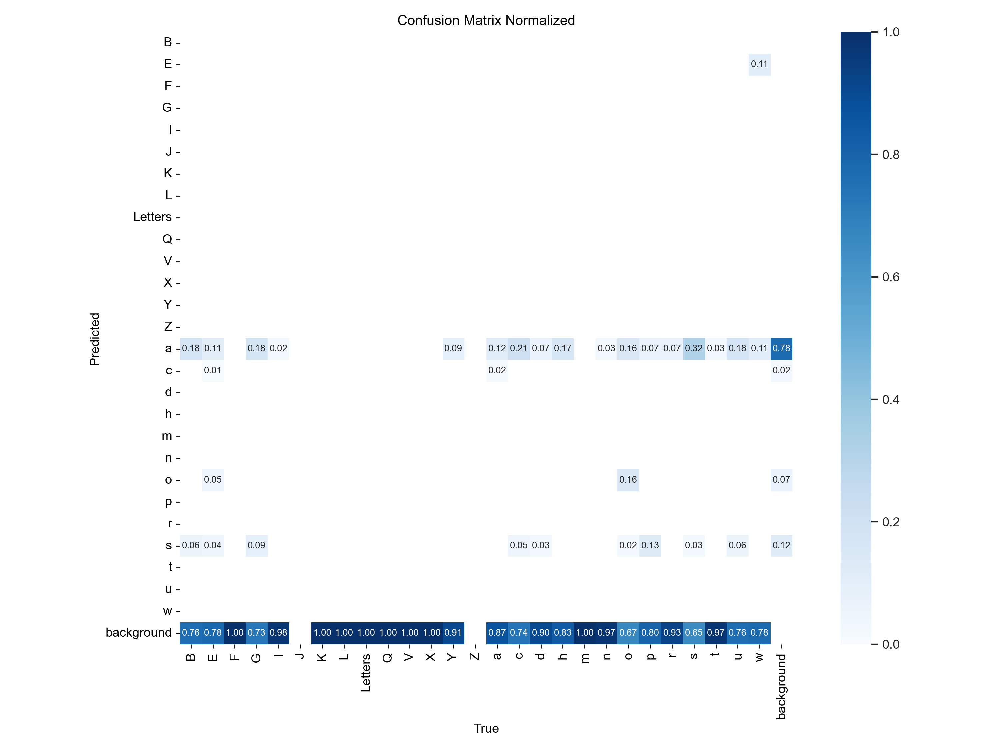

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/train232/confusion_matrix_normalized.png")

In [ ]:
# test model on same image

model55("/Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg: 352x640 (no detections), 270.5ms
Speed: 5.2ms preprocess, 270.5ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)
Results saved to runs/detect/train233


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'B', 1: 'E', 2: 'F', 3: 'G', 4: 'I', 5: 'J', 6: 'K', 7: 'L', 8: 'Letters', 9: 'Q', 10: 'V', 11: 'X', 12: 'Y', 13: 'Z', 14: 'a', 15: 'c', 16: 'd', 17: 'h', 18: 'm', 19: 'n', 20: 'o', 21: 'p', 22: 'r', 23: 's', 24: 't', 25: 'u', 26: 'w'}
 obb: None
 orig_img: array([[[165, 171, 170],
         [171, 177, 176],
         [173, 179, 178],
         ...,
         [159, 165, 164],
         [147, 153, 152],
         [154, 160, 159]],
 
        [[158, 164, 163],
         [161, 167, 166],
         [163, 169, 168],
         ...,
         [173, 179, 178],
         [159, 165, 164],
         [161, 167, 166]],
 
        [[160, 166, 165],
         [159, 165, 164],
         [159, 165, 164],
         ...,
         [173, 179, 178],
         [158, 164, 163],
         [159, 165, 164]],
 
        ...,
 
        [[162, 168, 167],
         [161, 167, 166],
     

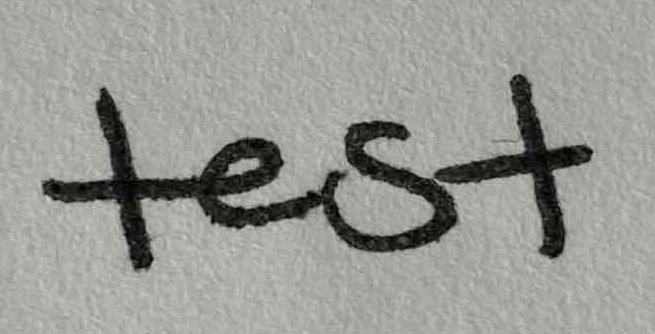

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/train233/IMG_9534.jpgtextcrop.jpg")

In [ ]:
model55("/Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/train/images/0a968549-20download_png.rf.97a45c6684f56bc732970138bda02cb9.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/train/images/0a968549-20download_png.rf.97a45c6684f56bc732970138bda02cb9.jpg: 128x640 1 o, 145.6ms
Speed: 2.7ms preprocess, 145.6ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 640)
Results saved to runs/detect/train234


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'B', 1: 'E', 2: 'F', 3: 'G', 4: 'I', 5: 'J', 6: 'K', 7: 'L', 8: 'Letters', 9: 'Q', 10: 'V', 11: 'X', 12: 'Y', 13: 'Z', 14: 'a', 15: 'c', 16: 'd', 17: 'h', 18: 'm', 19: 'n', 20: 'o', 21: 'p', 22: 'r', 23: 's', 24: 't', 25: 'u', 26: 'w'}
 obb: None
 orig_img: array([[[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        ...,
 
        [[255, 255, 255],
         [244, 244, 244],
     

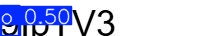

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/train234/0a968549-20download_png.rf.97a45c6684f56bc732970138bda02cb9.jpg")

#### Model55 with more data performs worse than it did before.
Strangely the more data I train the letter-detection model with, the worse it gets. The best we have so far is model4, so I will use that one going forward.


### D. Testing
Using test set images to check model4 accuracy.

In [ ]:
# load up best model I could train
model4 = YOLO("/Users/oliviasteed/runs/detect/train11/weights/best.pt")

In [ ]:
# test model with test images

model4("/Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/IMG_9534.jpgtextcrop.jpg: 352x640 1 5, 1 S, 238.8ms
Speed: 5.1ms preprocess, 238.8ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Results saved to runs/detect/predict25


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: '0', 1: '1', 2: '2', 3: '3', 4: '4', 5: '5', 6: '6', 7: '7', 8: '8', 9: '9', 10: 'A', 11: 'B', 12: 'C', 13: 'D', 14: 'E', 15: 'F', 16: 'G', 17: 'H', 18: 'I', 19: 'J', 20: 'K', 21: 'L', 22: 'M', 23: 'N', 24: 'O', 25: 'P', 26: 'Q', 27: 'R', 28: 'S', 29: 'T', 30: 'U', 31: 'V', 32: 'W', 33: 'X', 34: 'Y', 35: 'Z', 36: 'a', 37: 'b', 38: 'c', 39: 'd', 40: 'e', 41: 'f', 42: 'g', 43: 'h', 44: 'i', 45: 'j', 46: 'k', 47: 'l', 48: 'm', 49: 'n', 50: 'o', 51: 'p', 52: 'q', 53: 'r', 54: 's', 55: 't', 56: 'u', 57: 'v', 58: 'w', 59: 'x', 60: 'y', 61: 'z'}
 obb: None
 orig_img: array([[[165, 171, 170],
         [171, 177, 176],
         [173, 179, 178],
         ...,
         [159, 165, 164],
         [147, 153, 152],
         [154, 160, 159]],
 
        [[158, 164, 163],
         [161, 167, 166],
         [163, 169, 168],
         ...,
         [173, 17

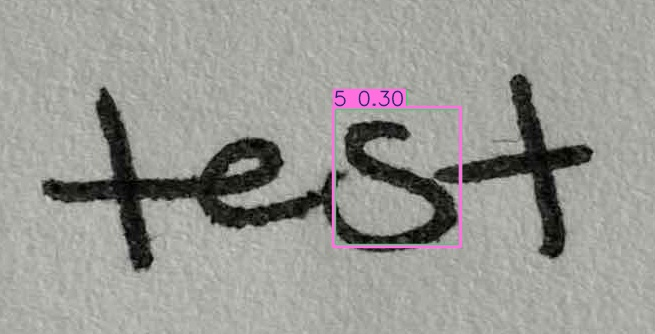

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict25/IMG_9534.jpgtextcrop.jpg")

In [ ]:
# test on more
model4("/Users/oliviasteed/Desktop/Letters Dataset/Letters/test/images/HC-CD2OKKS_95_jpg.rf.08970a0411f6ab9365d4c9335c5e9c7d.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/Letters Dataset/Letters/test/images/HC-CD2OKKS_95_jpg.rf.08970a0411f6ab9365d4c9335c5e9c7d.jpg: 640x640 (no detections), 359.3ms
Speed: 5.3ms preprocess, 359.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict25


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: '0', 1: '1', 2: '2', 3: '3', 4: '4', 5: '5', 6: '6', 7: '7', 8: '8', 9: '9', 10: 'A', 11: 'B', 12: 'C', 13: 'D', 14: 'E', 15: 'F', 16: 'G', 17: 'H', 18: 'I', 19: 'J', 20: 'K', 21: 'L', 22: 'M', 23: 'N', 24: 'O', 25: 'P', 26: 'Q', 27: 'R', 28: 'S', 29: 'T', 30: 'U', 31: 'V', 32: 'W', 33: 'X', 34: 'Y', 35: 'Z', 36: 'a', 37: 'b', 38: 'c', 39: 'd', 40: 'e', 41: 'f', 42: 'g', 43: 'h', 44: 'i', 45: 'j', 46: 'k', 47: 'l', 48: 'm', 49: 'n', 50: 'o', 51: 'p', 52: 'q', 53: 'r', 54: 's', 55: 't', 56: 'u', 57: 'v', 58: 'w', 59: 'x', 60: 'y', 61: 'z'}
 obb: None
 orig_img: array([[[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 25

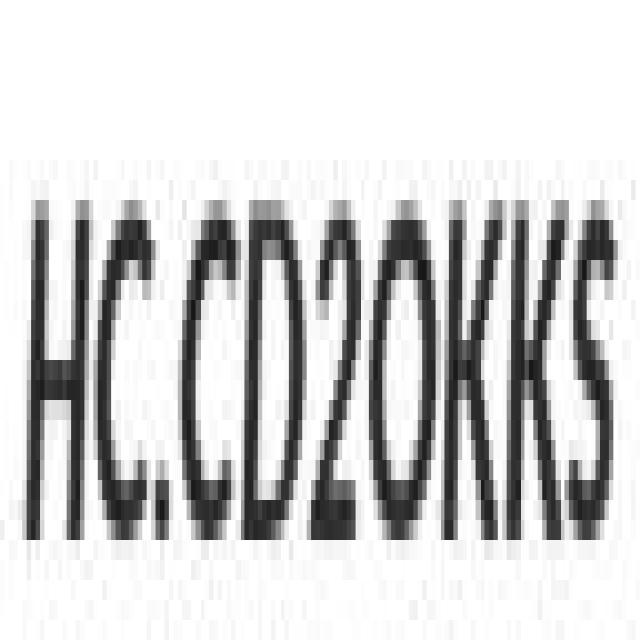

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict25/HC-CD2OKKS_95_jpg.rf.08970a0411f6ab9365d4c9335c5e9c7d.jpg")

In [ ]:
# test on more
model4("/Users/oliviasteed/Desktop/Letters Dataset/SuperCaptcha/test/images/acaptchaacaptcha_php__CAPTCHA-t_0_29296300_1694270253_png.rf.954c2030496507b01b67d525c47ea35f.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/Letters Dataset/SuperCaptcha/test/images/acaptchaacaptcha_php__CAPTCHA-t_0_29296300_1694270253_png.rf.954c2030496507b01b67d525c47ea35f.jpg: 640x640 1 D, 358.8ms
Speed: 16.6ms preprocess, 358.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict25


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: '0', 1: '1', 2: '2', 3: '3', 4: '4', 5: '5', 6: '6', 7: '7', 8: '8', 9: '9', 10: 'A', 11: 'B', 12: 'C', 13: 'D', 14: 'E', 15: 'F', 16: 'G', 17: 'H', 18: 'I', 19: 'J', 20: 'K', 21: 'L', 22: 'M', 23: 'N', 24: 'O', 25: 'P', 26: 'Q', 27: 'R', 28: 'S', 29: 'T', 30: 'U', 31: 'V', 32: 'W', 33: 'X', 34: 'Y', 35: 'Z', 36: 'a', 37: 'b', 38: 'c', 39: 'd', 40: 'e', 41: 'f', 42: 'g', 43: 'h', 44: 'i', 45: 'j', 46: 'k', 47: 'l', 48: 'm', 49: 'n', 50: 'o', 51: 'p', 52: 'q', 53: 'r', 54: 's', 55: 't', 56: 'u', 57: 'v', 58: 'w', 59: 'x', 60: 'y', 61: 'z'}
 obb: None
 orig_img: array([[[242, 242, 242],
         [239, 239, 239],
         [243, 243, 243],
         ...,
         [234, 234, 234],
         [234, 234, 234],
         [233, 233, 233]],
 
        [[242, 242, 242],
         [239, 239, 239],
         [243, 243, 243],
         ...,
         [234, 23

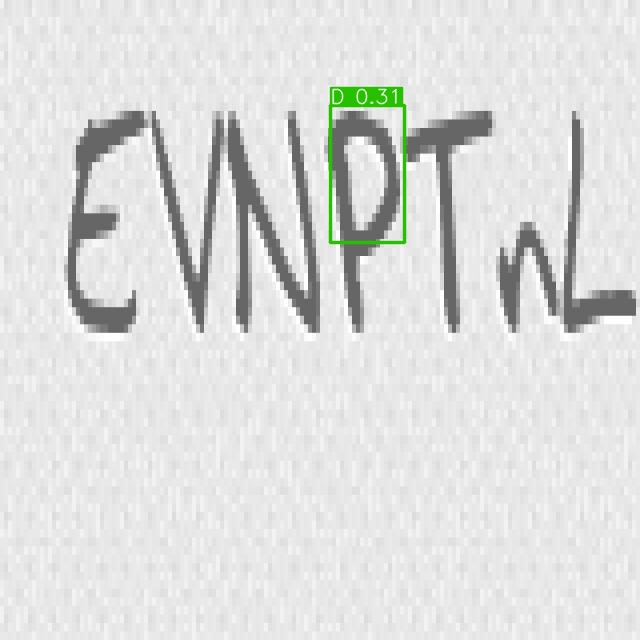

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict25/acaptchaacaptcha_php__CAPTCHA-t_0_29296300_1694270253_png.rf.954c2030496507b01b67d525c47ea35f.jpg")

In [ ]:
# test again
model4("/Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/valid/images/37b0eb9a-54createCaptcha_png.rf.5968b057789a05dc45fac71f94779947.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/valid/images/37b0eb9a-54createCaptcha_png.rf.5968b057789a05dc45fac71f94779947.jpg: 224x640 1 2, 1 H, 1 m, 228.3ms
Speed: 8.8ms preprocess, 228.3ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 640)
Results saved to runs/detect/predict25


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: '0', 1: '1', 2: '2', 3: '3', 4: '4', 5: '5', 6: '6', 7: '7', 8: '8', 9: '9', 10: 'A', 11: 'B', 12: 'C', 13: 'D', 14: 'E', 15: 'F', 16: 'G', 17: 'H', 18: 'I', 19: 'J', 20: 'K', 21: 'L', 22: 'M', 23: 'N', 24: 'O', 25: 'P', 26: 'Q', 27: 'R', 28: 'S', 29: 'T', 30: 'U', 31: 'V', 32: 'W', 33: 'X', 34: 'Y', 35: 'Z', 36: 'a', 37: 'b', 38: 'c', 39: 'd', 40: 'e', 41: 'f', 42: 'g', 43: 'h', 44: 'i', 45: 'j', 46: 'k', 47: 'l', 48: 'm', 49: 'n', 50: 'o', 51: 'p', 52: 'q', 53: 'r', 54: 's', 55: 't', 56: 'u', 57: 'v', 58: 'w', 59: 'x', 60: 'y', 61: 'z'}
 obb: None
 orig_img: array([[[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[251, 251, 251],
         [251, 251, 251],
         [251, 251, 251],
         ...,
         [251, 25

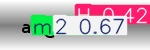

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict25/37b0eb9a-54createCaptcha_png.rf.5968b057789a05dc45fac71f94779947.jpg")

In [ ]:
# test again
model4("/Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/valid/images/413466bd-captcha46_png.rf.d83066d62535a9f20ae886cca2076216.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/valid/images/413466bd-captcha46_png.rf.d83066d62535a9f20ae886cca2076216.jpg: 192x640 1 2, 1 L, 1 U, 1 Z, 3082.8ms
Speed: 32.2ms preprocess, 3082.8ms inference, 22.1ms postprocess per image at shape (1, 3, 192, 640)
Results saved to runs/detect/predict25


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: '0', 1: '1', 2: '2', 3: '3', 4: '4', 5: '5', 6: '6', 7: '7', 8: '8', 9: '9', 10: 'A', 11: 'B', 12: 'C', 13: 'D', 14: 'E', 15: 'F', 16: 'G', 17: 'H', 18: 'I', 19: 'J', 20: 'K', 21: 'L', 22: 'M', 23: 'N', 24: 'O', 25: 'P', 26: 'Q', 27: 'R', 28: 'S', 29: 'T', 30: 'U', 31: 'V', 32: 'W', 33: 'X', 34: 'Y', 35: 'Z', 36: 'a', 37: 'b', 38: 'c', 39: 'd', 40: 'e', 41: 'f', 42: 'g', 43: 'h', 44: 'i', 45: 'j', 46: 'k', 47: 'l', 48: 'm', 49: 'n', 50: 'o', 51: 'p', 52: 'q', 53: 'r', 54: 's', 55: 't', 56: 'u', 57: 'v', 58: 'w', 59: 'x', 60: 'y', 61: 'z'}
 obb: None
 orig_img: array([[[243, 240, 235],
         [242, 231, 227],
         [255, 240, 240],
         ...,
         [253, 255, 254],
         [255, 255, 254],
         [255, 255, 254]],
 
        [[224, 220, 215],
         [184, 172, 168],
         [221, 190, 191],
         ...,
         [246, 24

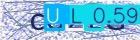

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict25/413466bd-captcha46_png.rf.d83066d62535a9f20ae886cca2076216.jpg")

In [ ]:
# compare to initial model2_saved onnx file
model2_saved = YOLO("/Users/oliviasteed/runs/detect/train11/weights/best.onnx")
model2_saved("/Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/valid/images/413466bd-captcha46_png.rf.d83066d62535a9f20ae886cca2076216.jpg", save=True)

Loading /Users/oliviasteed/runs/detect/train11/weights/best.onnx for ONNX Runtime inference...

image 1/1 /Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/valid/images/413466bd-captcha46_png.rf.d83066d62535a9f20ae886cca2076216.jpg: 640x640 1 2, 1 L, 1 U, 1 Z, 229.3ms
Speed: 12.7ms preprocess, 229.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict26


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: '0', 1: '1', 2: '2', 3: '3', 4: '4', 5: '5', 6: '6', 7: '7', 8: '8', 9: '9', 10: 'A', 11: 'B', 12: 'C', 13: 'D', 14: 'E', 15: 'F', 16: 'G', 17: 'H', 18: 'I', 19: 'J', 20: 'K', 21: 'L', 22: 'M', 23: 'N', 24: 'O', 25: 'P', 26: 'Q', 27: 'R', 28: 'S', 29: 'T', 30: 'U', 31: 'V', 32: 'W', 33: 'X', 34: 'Y', 35: 'Z', 36: 'a', 37: 'b', 38: 'c', 39: 'd', 40: 'e', 41: 'f', 42: 'g', 43: 'h', 44: 'i', 45: 'j', 46: 'k', 47: 'l', 48: 'm', 49: 'n', 50: 'o', 51: 'p', 52: 'q', 53: 'r', 54: 's', 55: 't', 56: 'u', 57: 'v', 58: 'w', 59: 'x', 60: 'y', 61: 'z'}
 obb: None
 orig_img: array([[[243, 240, 235],
         [242, 231, 227],
         [255, 240, 240],
         ...,
         [253, 255, 254],
         [255, 255, 254],
         [255, 255, 254]],
 
        [[224, 220, 215],
         [184, 172, 168],
         [221, 190, 191],
         ...,
         [246, 24

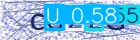

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict26/413466bd-captcha46_png.rf.d83066d62535a9f20ae886cca2076216.jpg")

Model4 and model2_saved perform almost the same, and perform best on the captcha-style images from the letters dataset because it trained on the most of those. This is probably a case of overfitting.

In [ ]:
model4("/Users/oliviasteed/Desktop/My Letters Dataset/test/images/18_png_jpg.rf.e864f627019bf64721066ed642d8d51b.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/My Letters Dataset/test/images/18_png_jpg.rf.e864f627019bf64721066ed642d8d51b.jpg: 640x640 1 m, 357.0ms
Speed: 5.7ms preprocess, 357.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict25


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: '0', 1: '1', 2: '2', 3: '3', 4: '4', 5: '5', 6: '6', 7: '7', 8: '8', 9: '9', 10: 'A', 11: 'B', 12: 'C', 13: 'D', 14: 'E', 15: 'F', 16: 'G', 17: 'H', 18: 'I', 19: 'J', 20: 'K', 21: 'L', 22: 'M', 23: 'N', 24: 'O', 25: 'P', 26: 'Q', 27: 'R', 28: 'S', 29: 'T', 30: 'U', 31: 'V', 32: 'W', 33: 'X', 34: 'Y', 35: 'Z', 36: 'a', 37: 'b', 38: 'c', 39: 'd', 40: 'e', 41: 'f', 42: 'g', 43: 'h', 44: 'i', 45: 'j', 46: 'k', 47: 'l', 48: 'm', 49: 'n', 50: 'o', 51: 'p', 52: 'q', 53: 'r', 54: 's', 55: 't', 56: 'u', 57: 'v', 58: 'w', 59: 'x', 60: 'y', 61: 'z'}
 obb: None
 orig_img: array([[[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 25

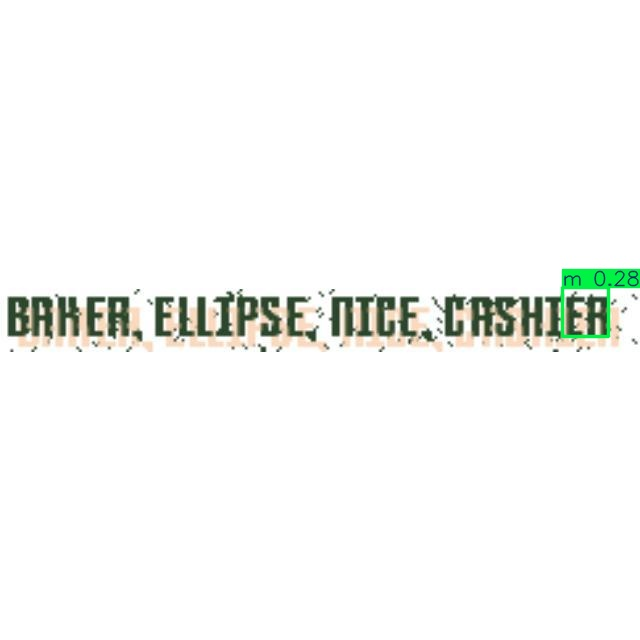

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict25/18_png_jpg.rf.e864f627019bf64721066ed642d8d51b.jpg")

Performance is not great.

## 3. Testing full workflow - text detection to letter detction using both models

Here I will pass a test image from the text detection dataset into the text detection model, identify if there is text, crop it, and then attempt to identify what the letters are with the letters detection model. This may make letter detection better since it reduces noise.

In [ ]:
# text detection (model)
textmodel = YOLO("/Users/oliviasteed/runs/detect/train3/weights/best.pt")

# letters detection (model4)
lettermodel = YOLO("/Users/oliviasteed/runs/detect/train11/weights/best.pt")

In [ ]:
imgresults1 = model("/Users/oliviasteed/Desktop/Text Dataset/images/test/img_108_jpg.rf.16f4a5334622fa07c6e80d615392eed1.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/Text Dataset/images/test/img_108_jpg.rf.16f4a5334622fa07c6e80d615392eed1.jpg: 640x640 1 Text, 1065.5ms
Speed: 43.6ms preprocess, 1065.5ms inference, 30.3ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict11


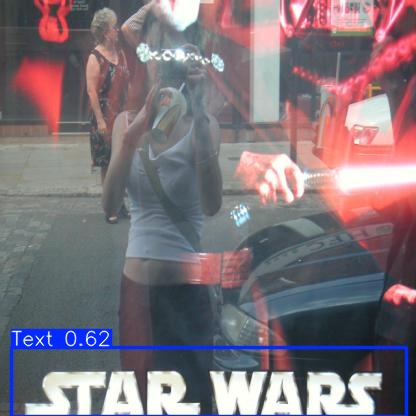

In [ ]:
# open text detection predicted image

Image.open("/Users/oliviasteed/runs/detect/predict11/img_108_jpg.rf.16f4a5334622fa07c6e80d615392eed1.jpg")

In [ ]:
# load up crop image function

def crop_image(model_results, og_image_path, name):

  for result in model_results[0].boxes.xyxy:  # Iterate through detected objects
    x_min, y_min, x_max, y_max = result.tolist()

  # load predicted test image
  # image = cv2.imread(output_path)
  image = cv2.imread(og_image_path)

  box_width = int(x_max - x_min)
  box_height = int(y_max - y_min)

  # print(box_width,",",box_height)

  crop = image[int(y_min):int(y_max), int(x_min):int(x_max)]
  # cv2.imwrite(og_image_path +"textcrop.jpg", crop)
  cv2.imwrite("/Users/oliviasteed/Desktop/cropped/"+name+ "textcrop.jpg", crop)

In [ ]:
# crop image
crop_image(imgresults1, "/Users/oliviasteed/runs/detect/predict11/img_108_jpg.rf.16f4a5334622fa07c6e80d615392eed1.jpg", "starwars")

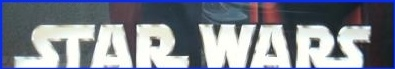

In [ ]:
# open textcrop image
Image.open("/Users/oliviasteed/Desktop/cropped/starwarstextcrop.jpg")

In [ ]:
# detect letters from textcrop image

lettermodel("/Users/oliviasteed/Desktop/cropped/starwarstextcrop.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/cropped/starwarstextcrop.jpg: 128x640 1 7, 120.9ms
Speed: 1.8ms preprocess, 120.9ms inference, 1.9ms postprocess per image at shape (1, 3, 128, 640)
Results saved to runs/detect/predict27


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: '0', 1: '1', 2: '2', 3: '3', 4: '4', 5: '5', 6: '6', 7: '7', 8: '8', 9: '9', 10: 'A', 11: 'B', 12: 'C', 13: 'D', 14: 'E', 15: 'F', 16: 'G', 17: 'H', 18: 'I', 19: 'J', 20: 'K', 21: 'L', 22: 'M', 23: 'N', 24: 'O', 25: 'P', 26: 'Q', 27: 'R', 28: 'S', 29: 'T', 30: 'U', 31: 'V', 32: 'W', 33: 'X', 34: 'Y', 35: 'Z', 36: 'a', 37: 'b', 38: 'c', 39: 'd', 40: 'e', 41: 'f', 42: 'g', 43: 'h', 44: 'i', 45: 'j', 46: 'k', 47: 'l', 48: 'm', 49: 'n', 50: 'o', 51: 'p', 52: 'q', 53: 'r', 54: 's', 55: 't', 56: 'u', 57: 'v', 58: 'w', 59: 'x', 60: 'y', 61: 'z'}
 obb: None
 orig_img: array([[[251,  43,   0],
         [248,  48,   5],
         [231,  45,  11],
         ...,
         [233,  45,  20],
         [235,  44,  11],
         [246,  43,   8]],
 
        [[248,  44,   3],
         [237,  44,   5],
         [215,  44,  12],
         ...,
         [206,  4

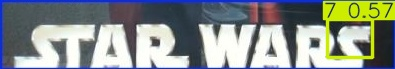

In [ ]:
# open letter predict image
Image.open("/Users/oliviasteed/runs/detect/predict27/starwarstextcrop.jpg")

In [ ]:
imgresults2 = textmodel("/Users/oliviasteed/Desktop/My Letters Dataset/test/images/img_125_jpg.rf.46ae17aee49524f0e4149ddd40ee2c78.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/My Letters Dataset/test/images/img_125_jpg.rf.46ae17aee49524f0e4149ddd40ee2c78.jpg: 640x640 1 Text, 389.1ms
Speed: 5.8ms preprocess, 389.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict28


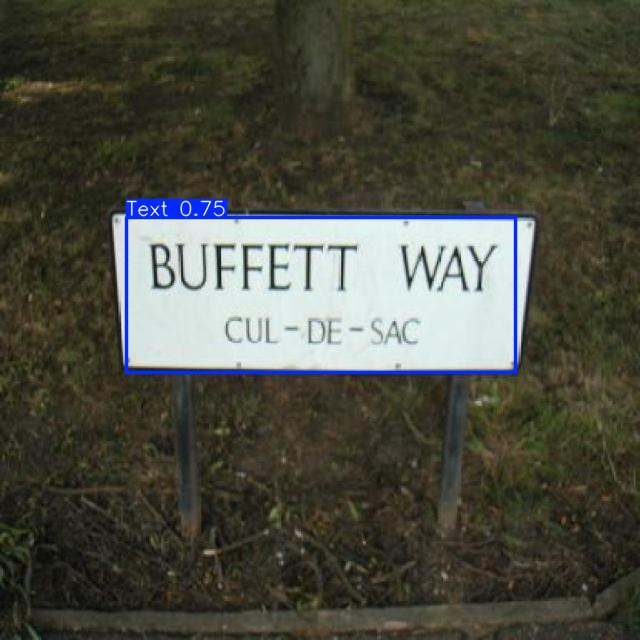

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict28/img_125_jpg.rf.46ae17aee49524f0e4149ddd40ee2c78.jpg")

In [ ]:
# crop text box
crop_image(imgresults2, "/Users/oliviasteed/runs/detect/predict28/img_125_jpg.rf.46ae17aee49524f0e4149ddd40ee2c78.jpg", "sign")

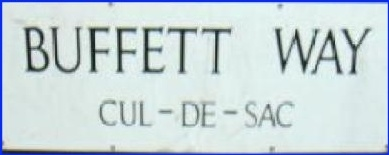

In [ ]:
Image.open("/Users/oliviasteed/Desktop/cropped/signtextcrop.jpg")

In [ ]:
letterresults = lettermodel("/Users/oliviasteed/Desktop/cropped/signtextcrop.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/cropped/signtextcrop.jpg: 256x640 1 N, 2 Ts, 1 U, 2 Ws, 1 Y, 240.8ms
Speed: 2.6ms preprocess, 240.8ms inference, 4.5ms postprocess per image at shape (1, 3, 256, 640)
Results saved to runs/detect/predict27


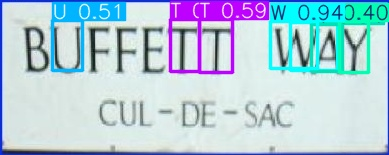

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict27/signtextcrop.jpg")

#### Print out detected letters
This would be more useful if all letters were detected

In [ ]:
# print out detected letters

def get_letters(results):
    # Access the prediction results
    predictions = results[0].boxes

    # Get the class names defined in your model configuration (data.yaml)
    class_names = lettermodel.names
    wordstring = ""

    # Extract and print the detected letters
    for p in predictions:
        class_id = int(p.cls[0])  # Get the class ID
        letter = class_names[class_id]  # Get corresponding letter
        wordstring = wordstring + letter

    return wordstring

In [ ]:
print(get_letters(letterresults))

WTUYTNW


In [ ]:
# test 3
img_path = "/Users/oliviasteed/Desktop/My Letters Dataset/test/images/"
img_name = "img_24_jpg.rf.864fc853086371688d8bb7395c40668c.jpg"

imgresults3 = textmodel(img_path+img_name, save=True)


image 1/1 /Users/oliviasteed/Desktop/My Letters Dataset/test/images/img_24_jpg.rf.864fc853086371688d8bb7395c40668c.jpg: 640x640 2 Texts, 362.3ms
Speed: 17.5ms preprocess, 362.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict28


In [ ]:
crop_image(imgresults3, img_path+img_name, "letters")

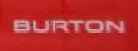

In [ ]:
Image.open("/Users/oliviasteed/Desktop/cropped/letterstextcrop.jpg")

In [ ]:
letterresults2 = lettermodel("/Users/oliviasteed/Desktop/cropped/letterstextcrop.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/cropped/letterstextcrop.jpg: 256x640 1 U, 1 m, 1 w, 253.3ms
Speed: 3.4ms preprocess, 253.3ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 640)
Results saved to runs/detect/predict27


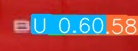

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict27/letterstextcrop.jpg")

In [ ]:
print(get_letters(letterresults2))

Uwm


Test 4

In [ ]:
img_path = "/Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/valid/images/"
img_name = "0e577d76-80download_png.rf.7234d88bf146b7c52e85821f6e0640b5.jpg"

imgresults4 = textmodel(img_path+img_name, save=True)


image 1/1 /Users/oliviasteed/Desktop/Letters Dataset/NewCaptcha/valid/images/0e577d76-80download_png.rf.7234d88bf146b7c52e85821f6e0640b5.jpg: 160x640 1 Text, 171.1ms
Speed: 3.6ms preprocess, 171.1ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)
Results saved to runs/detect/predict28


In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict28/0e577d76-80download_png.rf.7234d88bf146b7c52e85821f6e0640b5.jpg")

In [ ]:
crop_image(imgresults4, img_path+img_name, "captcha1")

In [ ]:
Image.open("/Users/oliviasteed/Desktop/cropped/captcha1textcrop.jpg")

In [ ]:
lettersresults3 = lettermodel("/Users/oliviasteed/Desktop/cropped/captcha1textcrop.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/cropped/captcha1textcrop.jpg: 160x640 1 2, 1 7, 1 E, 1 N, 1 P, 1 T, 186.4ms
Speed: 4.1ms preprocess, 186.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)
Results saved to runs/detect/predict27


In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict27/captcha1textcrop.jpg")

In [ ]:
get_letters(lettersresults3)

'2PNTE7'

## 4. Demo use case tests

### Test 1

In [ ]:
imgresults5 = textmodel("/Users/oliviasteed/Desktop/testimg.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/testimg.jpg: 480x640 4 Texts, 363.7ms
Speed: 7.1ms preprocess, 363.7ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict28


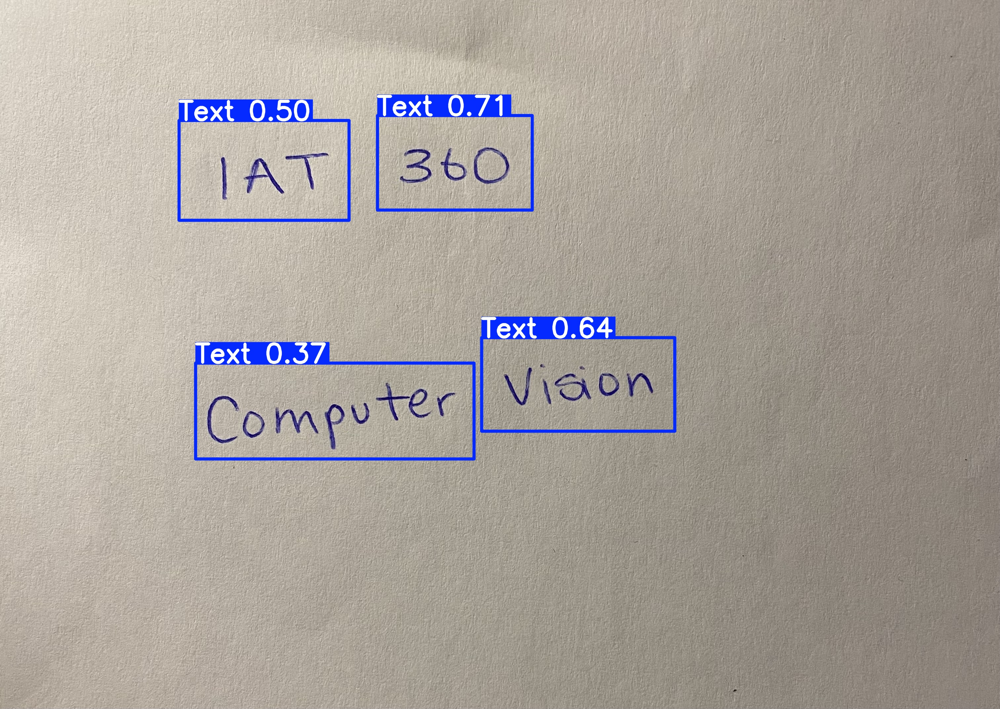

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict28/testimg.jpg")

In [ ]:
crop_image(imgresults5, "/Users/oliviasteed/runs/detect/predict28/testimg.jpg", "testimg")

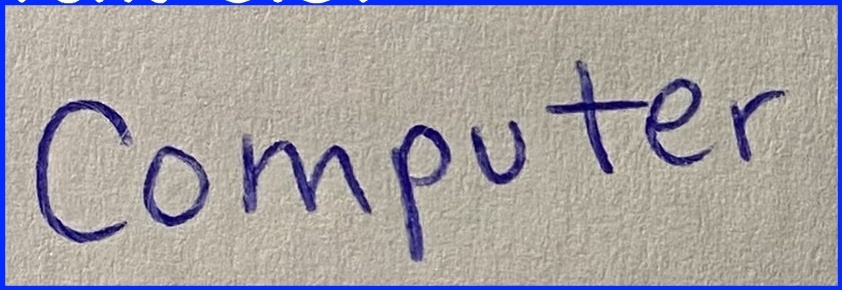

In [ ]:
Image.open("/Users/oliviasteed/Desktop/cropped/testimgtextcrop.jpg")

In [ ]:
lettersresults4 = lettermodel("/Users/oliviasteed/Desktop/cropped/testimgtextcrop.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/cropped/testimgtextcrop.jpg: 224x640 1 9, 1 C, 1 G, 1 N, 1 T, 1 U, 1 m, 202.2ms
Speed: 8.0ms preprocess, 202.2ms inference, 2.1ms postprocess per image at shape (1, 3, 224, 640)
Results saved to runs/detect/predict27


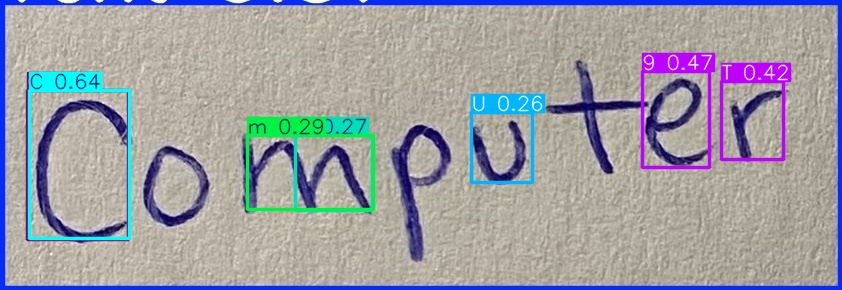

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict27/testimgtextcrop.jpg")

In [ ]:
get_letters(lettersresults4)

'CG9TmNU'

### Test 2

In [ ]:
imgresults9 = textmodel("/Users/oliviasteed/Desktop/testimg5.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/testimg5.jpg: 640x544 1 Text, 470.3ms
Speed: 10.0ms preprocess, 470.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 544)
Results saved to runs/detect/predict28


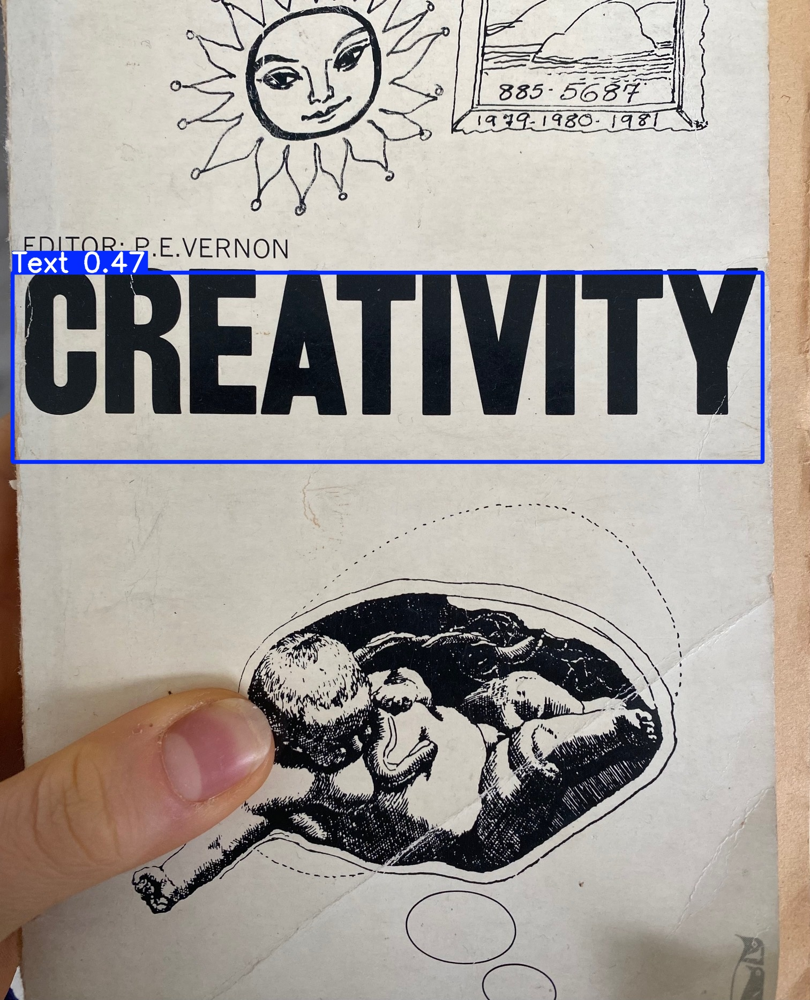

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict28/testimg5.jpg")

In [ ]:
crop_image(imgresults9, "/Users/oliviasteed/runs/detect/predict28/testimg5.jpg", "testimg5")

In [ ]:
letterresults8 = lettermodel("/Users/oliviasteed/Desktop/cropped/testimg5textcrop.jpg", save=True)


image 1/1 /Users/oliviasteed/Desktop/cropped/testimg5textcrop.jpg: 192x640 1 E, 185.5ms
Speed: 1.6ms preprocess, 185.5ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 640)
Results saved to runs/detect/predict27


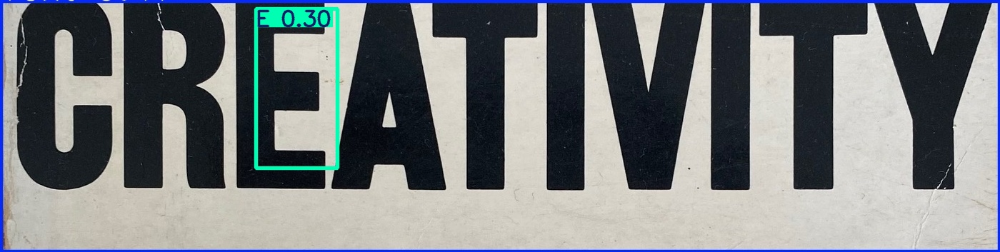

In [ ]:
Image.open("/Users/oliviasteed/runs/detect/predict27/testimg5textcrop.jpg")

In [ ]:
get_letters(letterresults8)

'E'